In [19]:
# packages
import pandas as pd
import numpy as np

from claspy.segmentation import BinaryClaSPSegmentation

import ruptures as rpt

import stumpy
from aeon.segmentation import find_dominant_window_sizes

from aeon.segmentation import GreedyGaussianSegmenter

from aeon.segmentation import InformationGainSegmenter

from aeon.anomaly_detection import STRAY

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, make_scorer,mean_squared_error
from ruptures.metrics import precision_recall
import matplotlib.pyplot as plt
#from aeon.visualisation import plot_series_with_change_points, plot_series_with_profiles
import seaborn as sns

sns.set_theme()
sns.set_color_codes()

from claspy.tests.evaluation import f_measure,covering

In [20]:
def f1scoremargin(ground_truth, predictions, tolerance):
    """
    Calcola l'F1 score con una finestra di tolleranza sui change points.
    
    :param ground_truth: Lista o array di change points reali
    :param predictions: Lista o array di change points predetti
    :param tolerance: La tolleranza temporale (numero di unità temporali)
    :return: precision, recall, f1-score
    """
    ground_truth = np.array(ground_truth)
    predictions = np.array(predictions)
    
    # Vettori per tracciare quali punti sono stati già associati
    matched_ground_truth = np.zeros(len(ground_truth), dtype=bool)
    matched_predictions = np.zeros(len(predictions), dtype=bool)

    mgt={key: False for key in ground_truth}
    mcp={key: False for key in predictions}
    #print(f'gt:{len(ground_truth)} - cp:{len(predictions)}')
    # True Positives (TP)
    tp = 0
    for i, gt_point in enumerate(ground_truth):
        for j, pred_point in enumerate(predictions):
            if not matched_predictions[j] and abs(gt_point - pred_point) <= tolerance:
                tp += 1
                matched_ground_truth[i] = True
                matched_predictions[j] = True

                mgt[gt_point] = True
                mcp[pred_point] = True
                break
            
    
    # False Positives (FP) - predizioni non corrispondenti a nessun ground truth entro la tolleranza
    fp = np.sum(~matched_predictions)
    
    # False Negatives (FN) - punti del ground truth non corrispondenti a nessuna predizione entro la tolleranza
    fn = np.sum(~matched_ground_truth)
    #print(f'tp:{tp} - fp:{fp} - fn:{fn}')
    #print(mgt)
    #print(mcp)
    # Calcolo di precision, recall e F1-score
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
    
    return precision, recall, f1

In [21]:
# Questi sono tutte le features estratte
# kineticglobal,kineticchest,directnesshead,density,leftwristke,rightwristke,leftankleke,rightankleke,headke,posturaltension

# Queste sono le feature che utilizzeremo
# kineticglobal, density, leftwirstke, rightwristke, leftankleke, rightankleke, headke, posturaltension
# che corrispondono
# 2,4,5,6,7,8,9,10,11
# Questa funzione legge il file di input e restituisce un dataframe con i dati preprocessati
def ReadAndPreProcess(inputDataRaw):
    # lettura
    df=pd.read_csv(inputDataRaw,sep=' ', header=None)
    df.drop(0, axis=1)
    df["som"]=df.sum(axis=1)
    ## preprocessing

    # dealing NaN values
    #-serafino ha usato forward fill, backward fill, linear interpolation
    #-ricordo che serafino aveva gia utilizzato sta cosa sui dati grezzi non sulle feature ma sui dati prefeature percio dovrebbe essere gia apposto

    # downsampling
    #-sono a 100ms, non sò se devo scendere a 50ms. da decidere
    #-non lo faccio xk non mi interessa se va piu lento, guarda su notion per ulteriori informazioni

    # low pass filter
    #-Skogstad and colleagues (2013) e https://stackoverflow.com/questions/25191620/creating-lowpass-filter-in-scipy-understanding-methods-and-units
    #-implementare dopo

    # remove outliers
    #-utilizzare hampel filter

    # stretch
    #-forse devo stretcharlo come ho fatto precedentemente
    #-anche se nel codice precedente ho stretchato solo il groundtruth

    # ritorno un oggetto dataframe dopo che è stato lavorato, ottenendo un prodotto lavorato
    return df


In [22]:
# questa funzione ritorna un dataframe del groundtruth che viene usato specificatamente per visualizzare il gt
# è soggetto a un preprocessing dei dati siccome l'ultimo groundtruth è dove termina il ts del gt
# di conseguenza per farlo corrispondere, bisogna stretcharlo
# ma ricordo di aver rifatti i dati nuovi per generare un groundtruth a fine ts, da controllare cosi che non serve stretcharlo?
def LoadingGroundTruth(df,gtraw):
    gt=pd.read_csv(gtraw,sep=' ', header=None)
    gt=gt.iloc[:,0].values
    #stretching dei dati se necessario per farlo corrispondere alla ts dei dati
    stretch_gt = np.array([])
    for idx,i in enumerate(gt):
        relpos = len(df)*i/gt[-1]
        stretch_gt = np.append(stretch_gt,relpos)

    # eliminiamo l'ultimo elemento che è stato annotato solo per delimitare la lunghezza della gt simile alla ts
    return stretch_gt[:-1]

In [23]:
# utilizzo CLASP 
# prende come parametro un dataframe e restituisce il clasp score
# gt e known vengono usati per usare il numero vero di cp se uguale a 1 sennò si cerca di predirlo se il modello lo permette
def GetClasp(df,gt,known, **kwargs):
    
    result=np.array([])
    eachresult = []
    eachclasp=[]
    for idx,i in enumerate([2,4,5,6,7,8,9,10,11]):
      
        ts=df.iloc[:,i]
        clasp = BinaryClaSPSegmentation(**kwargs)
        found_cps = clasp.fit_predict(ts.values)    

        # c'è un bug con binseg dove un cp è oltre la lunghezza del ts
        # faccio un loop e se eccede cambio il valore con la len(tf)-1
        for i in range(0,len(found_cps)):
            if found_cps[i] >= len(ts):
                found_cps[i] = len(ts)-1

        # per ogni array di cp di ogni singola feature
        # li unisco in un unico array. in pratica faccio un OR di tutti i cp
        result = np.sort(np.append(result,found_cps).flatten())
        result = np.unique(result)
        eachresult.append(found_cps)
        eachclasp.append(clasp)
        
        

        
    return result, eachresult, eachclasp
        
    


In [24]:
# calcola i vari scores dati il groundtruth e il prediction
# puo salvare il risultato su file per evitare di perderli
# prende come parametro nome del groundtruth, groundtruth, nome della timeseries e il prediction
def Evaluate(modelName,gtName, gt, tsName, cp, df, margin,msg, nomeFile):
    # creo dei array di lunghezza come la ts cosi possono fare il confronto
    # sia per il gt che per il pd
  
    cpnump = np.array(cp)
    gtnump = np.array(gt)

    cp_long = np.zeros(len(df)+1)
    cp_long[cpnump.astype(int)]=1

    gt_long = np.zeros(len(df)+1)
    gt_long[gtnump.astype(int)]=1

    # calcolo lo score 
    print(f'f1margin: {f1scoremargin(gt.astype(int),cp.astype(int),margin)}')
    precision,recall,f1=f1scoremargin(gt.astype(int),cp.astype(int),margin)
     #scrivo su file il risultato
    f = open("outputFile/ClaSPallresultYESNUMCP", "a")
    f.write(nomeFile+"\n")
    f.write(msg+"\n")
    f.write("precision:"+str(precision)+" recall:"+str(recall)+" f1:"+str(f1)+" \n")
    f.write("\n")
    f.close()

In [25]:
def Plotclasp(eachclasp,gt,margin,eachcp,nomeFile):
    
    for idx,clasp in enumerate(eachclasp):
        clasp.plot(gt_cps=gt.astype(int), heading=f'f1margin: {f1scoremargin(gt.astype(int),eachcp[idx].astype(int),margin)} {nomeFile}', ts_name="suss", file_path="segmentation_example.png")


    
        for idx2,j in enumerate(gt.astype(int)):
            plt.fill_betweenx(np.array([0, 1]), j-margin, j+margin, color='green', alpha=0.3)


In [26]:
def PlotResult(df,gt,cp, nomeFile, margin):
    #da testare quando ho piu valori
    #clasp.plot(gt_cps=gt.astype(int), heading="Segmentation of different umpire cricket signals", ts_name="ACC", file_path="segmentation_example.png")

    plt.figure(figsize=(18,9))
    plt.plot(np.arange(len(df["som"].values)),df["som"].values,'blue',linewidth=0.5)
    for idx2,i in enumerate(gt.astype(int)):

            plt.axvline(x = i, color = 'green',linewidth=1) 
            
    for j in cp.tolist():
        plt.axvline(x = j, color = 'red',linewidth=1,linestyle="-.") 

    for idx2,k in enumerate(gt.astype(int)):
            plt.fill_betweenx(np.array([0, 1]), k-margin, k+margin, color='green', alpha=0.3)
    plt.xlabel(f'{nomeFile} {f1scoremargin(gt.astype(int),cp.astype(int),margin)}')



In [27]:
timeseries=[
    "in\cora1_input.txt",
      "in\cora4_input.txt",
      "in\cora5_input.txt",
      "in\cora14_input.txt",
      "in\marianne7_input.txt",
      "in\marianne8_input.txt",
      "in\marianne10_input.txt",
      "in\marianne18_input.txt",
      "in\marianne19_input.txt",
      "in\marianne24_input.txt",
      "in\marianne26_input.txt",
      "in\marianne41_input.txt",
      "in\marianne42_input.txt",
      "in\marianne43_input.txt",
      "in\marianne47_input.txt",
      "in\marianne48_input.txt",
      "in\muriel18_input.txt",
      "in\muriel26_input.txt",
      "in\muriel27_input.txt",
      "in\muriel30_input.txt"

      ]
groundtruth=[
         "gt\cora_gt_2019-08-08_t001_video01.txt",
         "gt\cora_gt_2019-08-08_t004_video01.txt",
         "gt\cora5_gt.txt",
         "gt\cora_gt_2019-08-08_t014_video01.txt",
         "gt\marianne_gt_2016-03-22_t007_video01.txt",
         "gt\marianne_gt_2016-03-22_t008_video01.txt",
         "gt\marianne_gt_2016-03-22_t010_video01.txt",
         "gt\marianne_gt_2016-03-22_t018_video01.txt",
         "gt\marianne_gt_2016-03-22_t019_video01.txt",
         "gt\marianne_gt_2016-03-22_t024_video01.txt",
         "gt\marianne_gt_2016-03-22_t026_video01.txt",
         "gt\marianne_gt_2016-03-22_t041_video01.txt",
         "gt\marianne_gt_2016-03-22_t042_video01.txt",
         "gt\marianne_gt_2016-03-22_t043_video01.txt",
         "gt\marianne_gt_2016-03-22_t047_video01.txt",
         "gt\marianne_gt_2016-03-22_t048_video01.txt",
         "gt\muriel_gt_2016-03-21_t018_video01.txt",
         "gt\muriel_gt_2016-03-21_t026_video01.txt",
         "gt\muriel_gt_2016-03-21_t027_video01.txt",
         "gt\muriel_gt_2016-03-23_t030_video01.txt"
         ]



0
f1margin: (0.14622641509433962, 0.96875, 0.2540983606557377)
1
f1margin: (0.18604651162790697, 1.0, 0.3137254901960785)
2
f1margin: (0.11594202898550725, 0.9411764705882353, 0.2064516129032258)
3
f1margin: (0.35294117647058826, 0.96, 0.5161290322580645)
4
f1margin: (0.19753086419753085, 0.7619047619047619, 0.31372549019607837)
5
f1margin: (0.40625, 0.9629629629629629, 0.5714285714285714)
6
f1margin: (0.373134328358209, 0.9615384615384616, 0.5376344086021505)
7
f1margin: (0.32894736842105265, 0.9615384615384616, 0.4901960784313726)
8
f1margin: (0.5180722891566265, 0.9555555555555556, 0.6718750000000001)
9
f1margin: (0.19801980198019803, 0.9090909090909091, 0.3252032520325203)
10
f1margin: (0.37735849056603776, 0.9523809523809523, 0.5405405405405405)
11
f1margin: (0.21666666666666667, 1.0, 0.3561643835616438)
12
f1margin: (0.11594202898550725, 0.8888888888888888, 0.20512820512820512)
13
f1margin: (0.20540540540540542, 0.9743589743589743, 0.3392857142857143)
14
f1margin: (0.372093023255

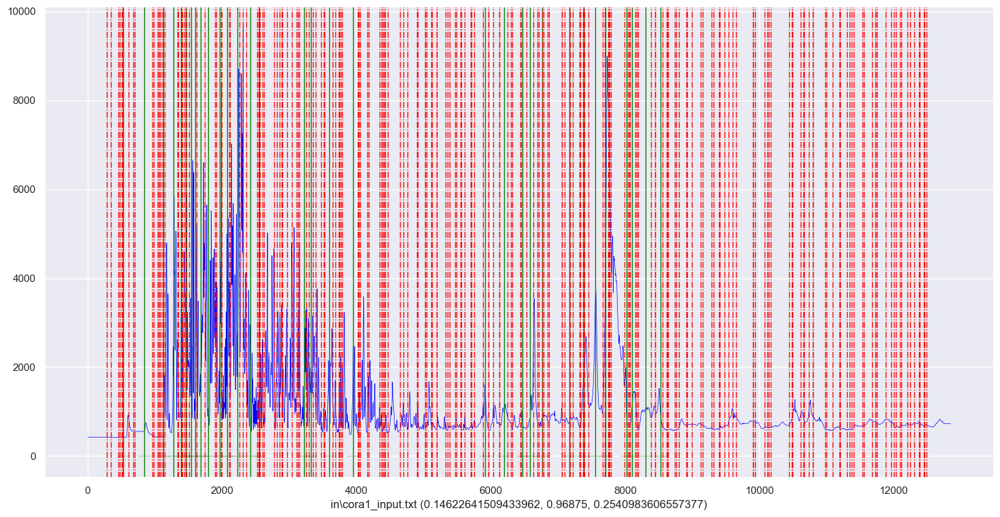

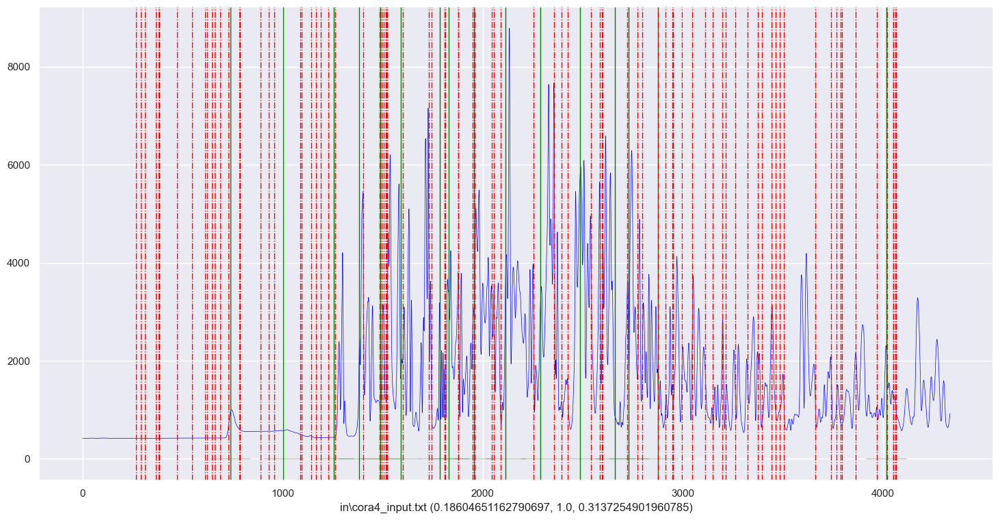

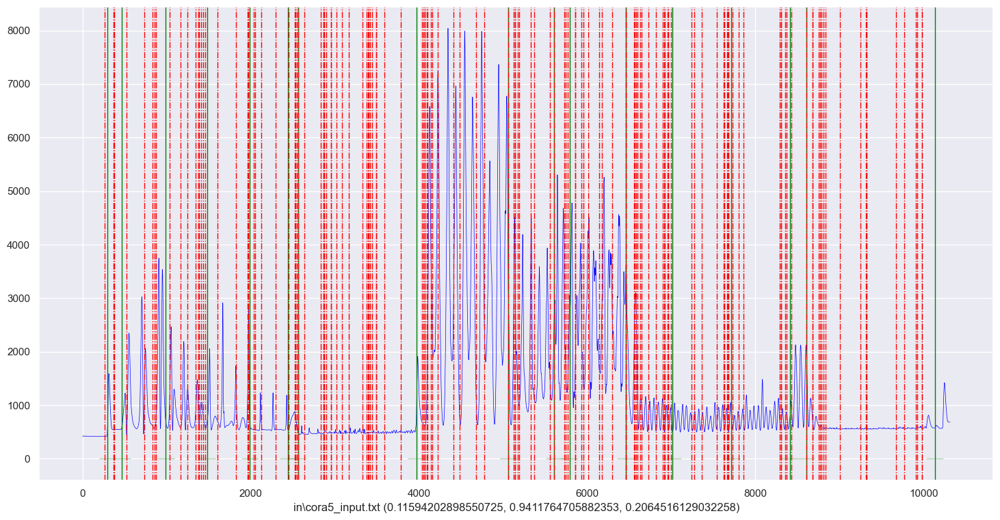

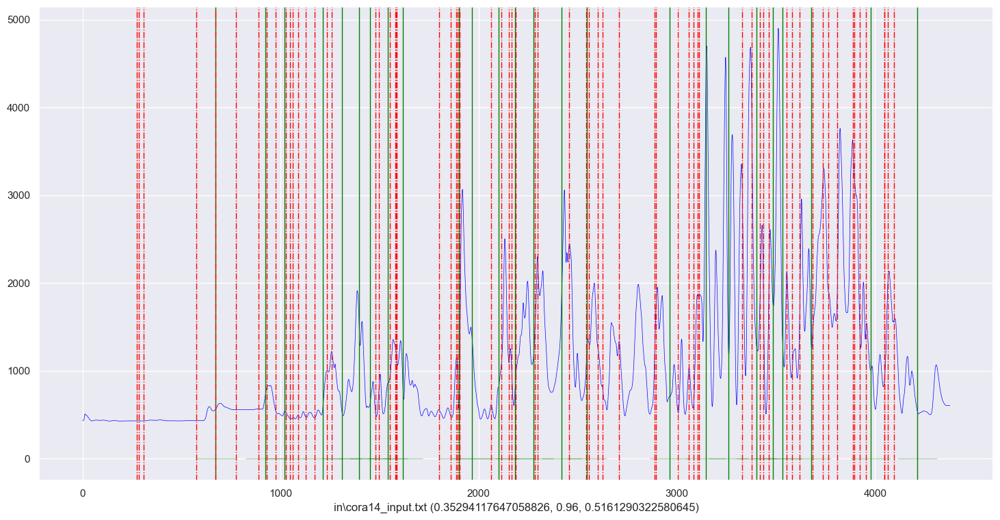

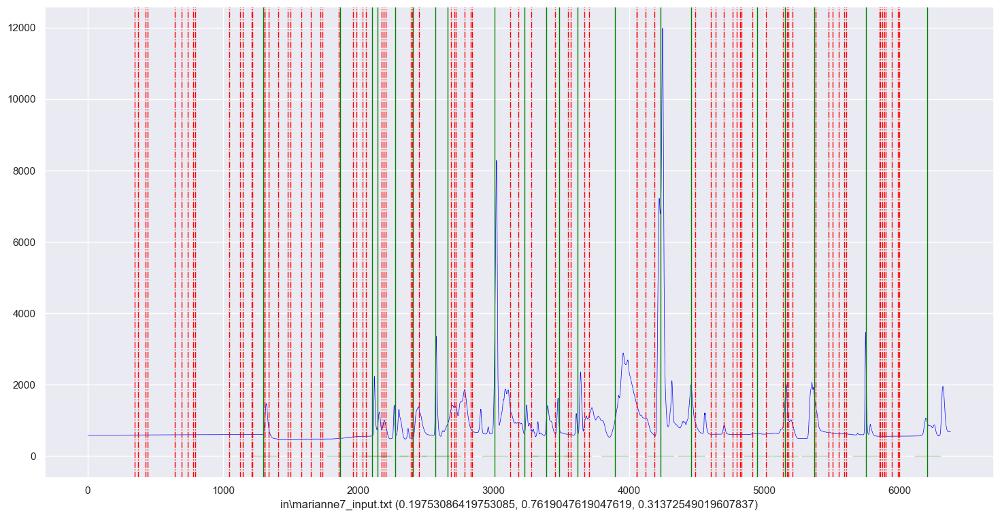

...

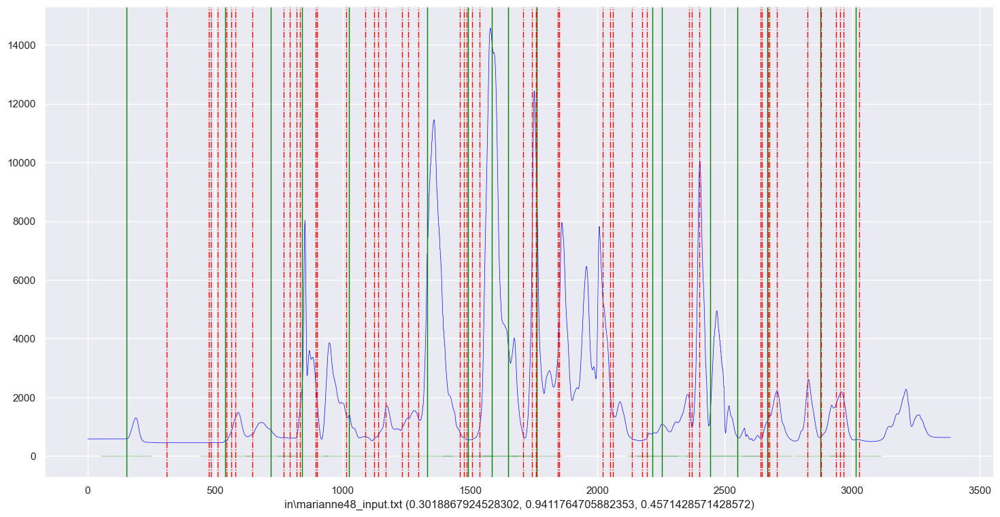

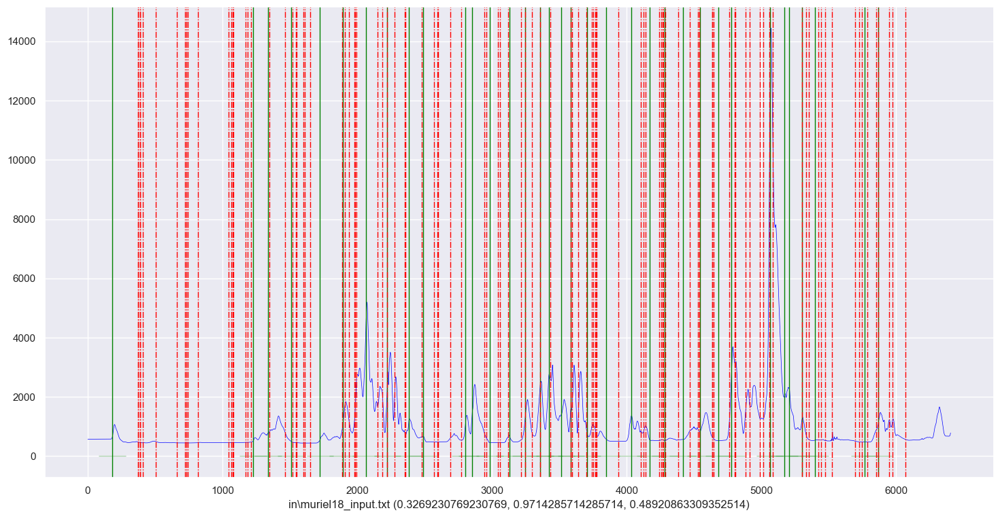

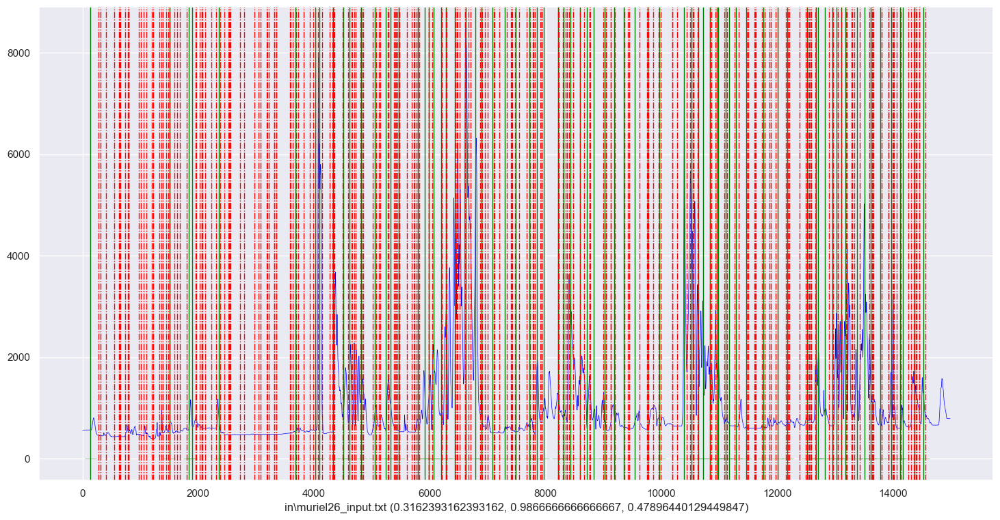

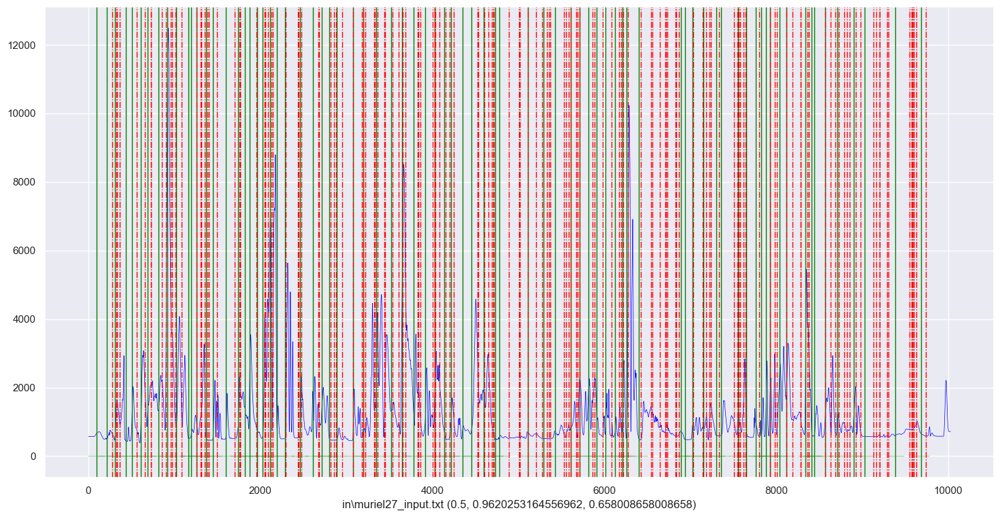

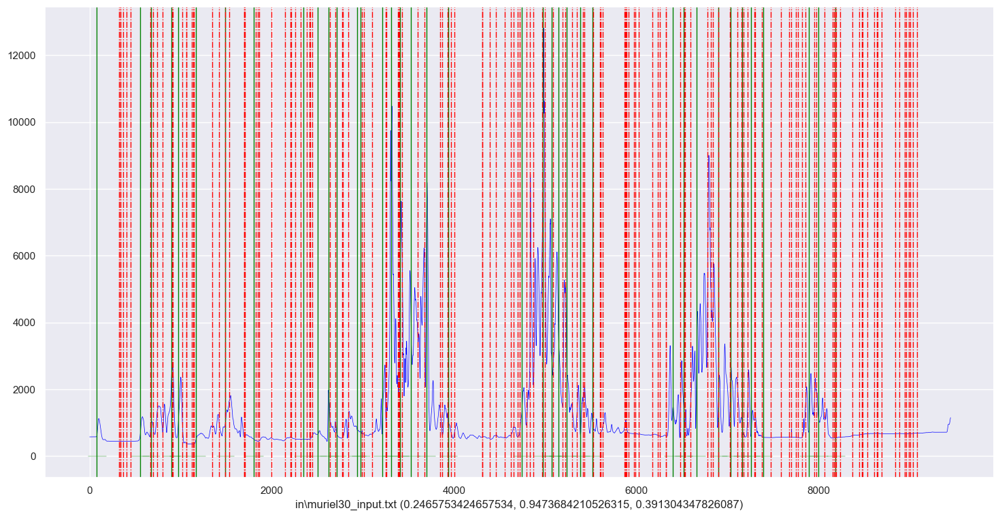

In [28]:
# suss
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,n_segments=len(gt), validation=None)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"suss",timeseries[i])

0
f1margin: (0.23404255319148937, 0.34375, 0.27848101265822783)
1
f1margin: (0.3684210526315789, 0.875, 0.5185185185185185)
2
f1margin: (0.1650485436893204, 1.0, 0.2833333333333334)
3
f1margin: (0.4791666666666667, 0.92, 0.6301369863013699)
4
f1margin: (0.29545454545454547, 0.6190476190476191, 0.4000000000000001)
5
f1margin: (0.7857142857142857, 0.4074074074074074, 0.5365853658536585)
6


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.38461538461538464, 0.5555555555555556)
7
f1margin: (0.5294117647058824, 0.6923076923076923, 0.5999999999999999)
8
f1margin: (0.9166666666666666, 0.4888888888888889, 0.6376811594202899)
9
f1margin: (0.3333333333333333, 0.6363636363636364, 0.43749999999999994)
10


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.7391304347826086, 0.8095238095238095, 0.7727272727272727)
11
f1margin: (0.4117647058823529, 0.5384615384615384, 0.4666666666666667)
12
f1margin: (0.1111111111111111, 0.3333333333333333, 0.16666666666666666)
13
f1margin: (0.4, 0.8717948717948718, 0.5483870967741936)
14


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.8666666666666667, 0.7647058823529411, 0.8125)
15


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.43243243243243246, 0.9411764705882353, 0.5925925925925927)
16
f1margin: (0.5555555555555556, 0.2857142857142857, 0.3773584905660377)
17
f1margin: (0.6304347826086957, 0.38666666666666666, 0.4793388429752066)
18
f1margin: (0.803030303030303, 0.6708860759493671, 0.7310344827586207)
19
f1margin: (0.6363636363636364, 0.3684210526315789, 0.4666666666666667)


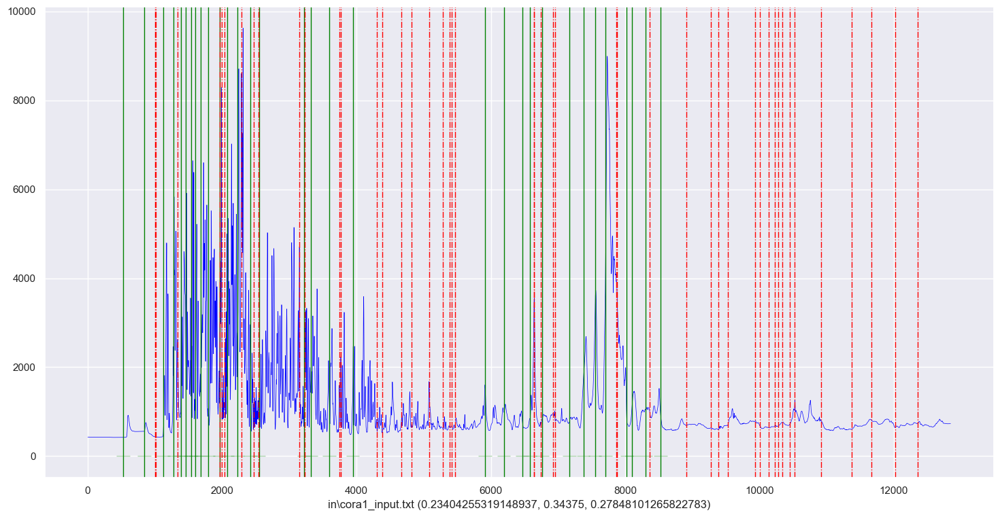

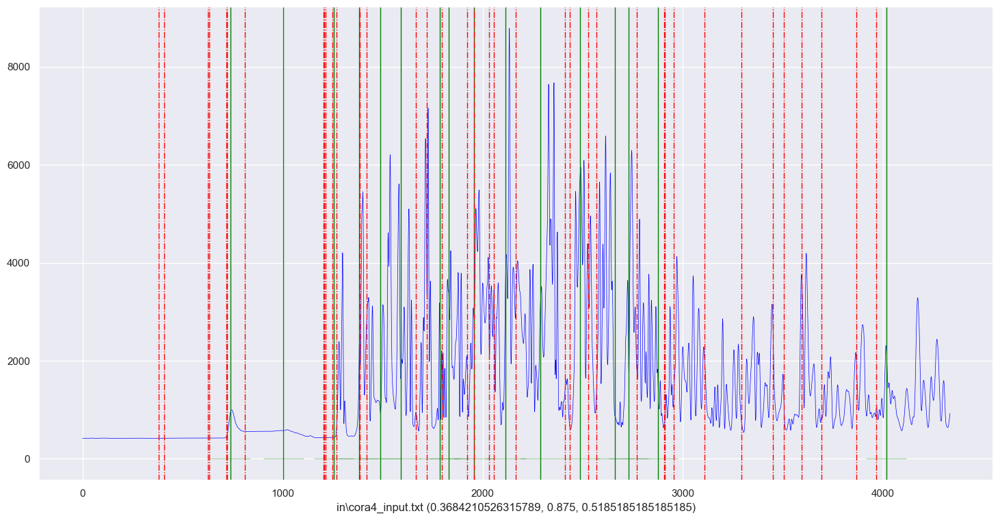

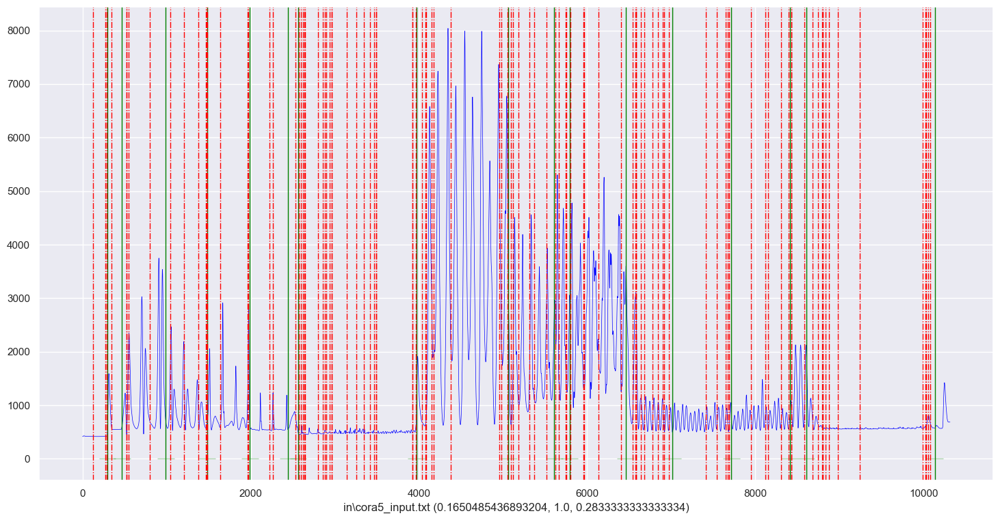

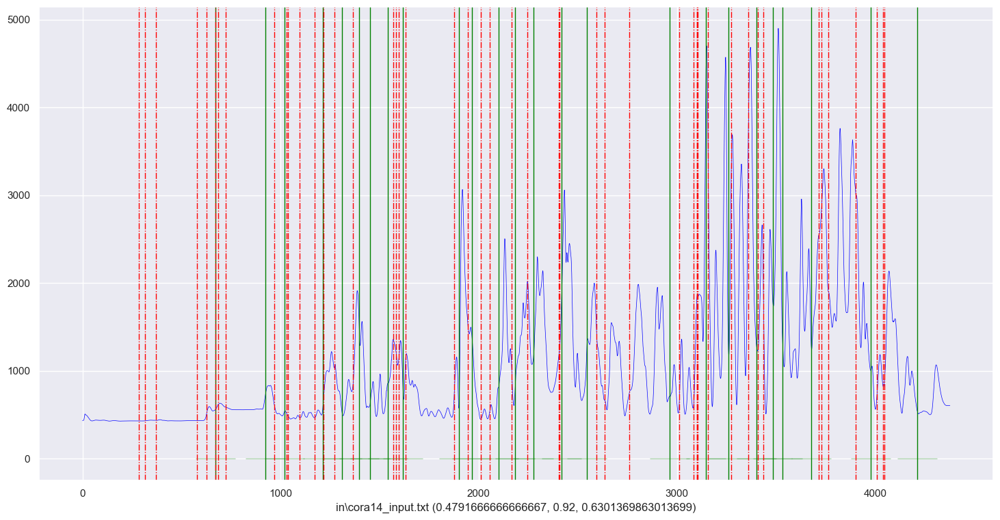

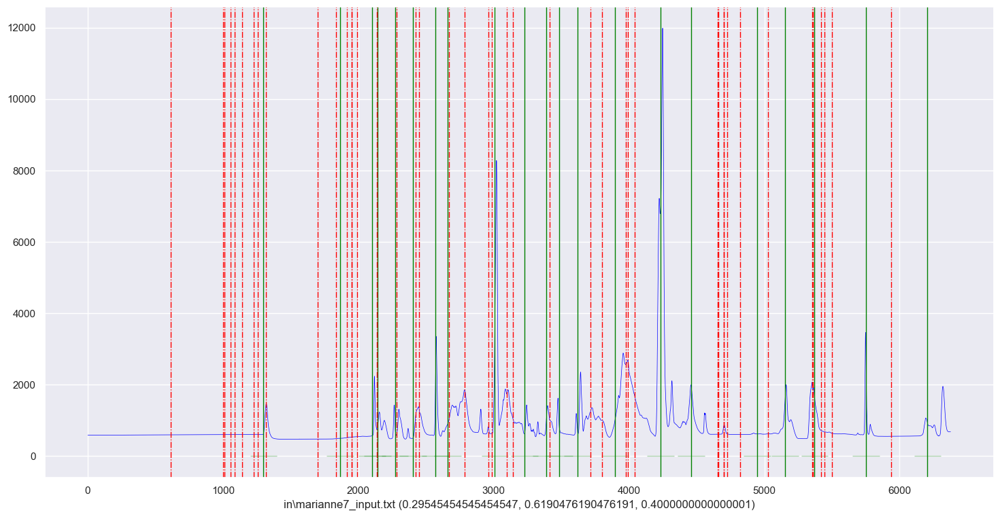

...

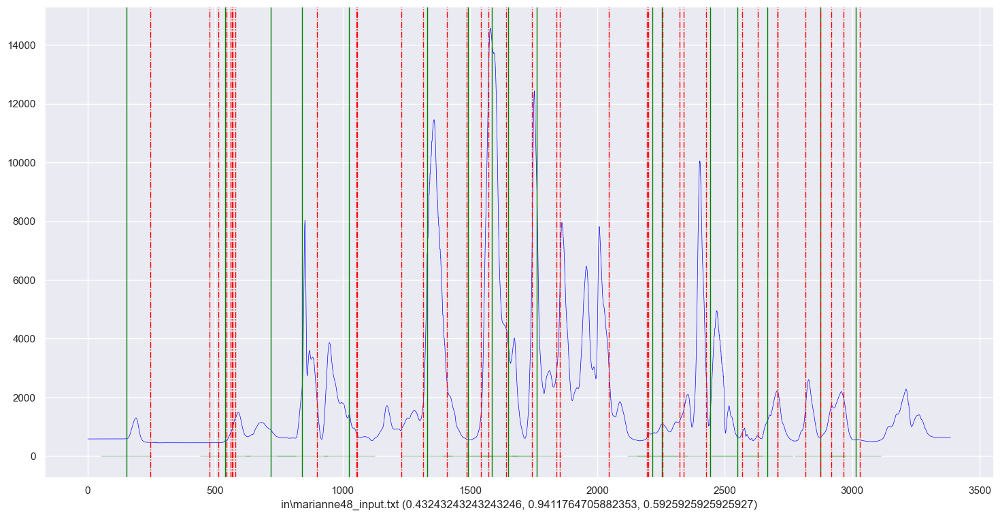

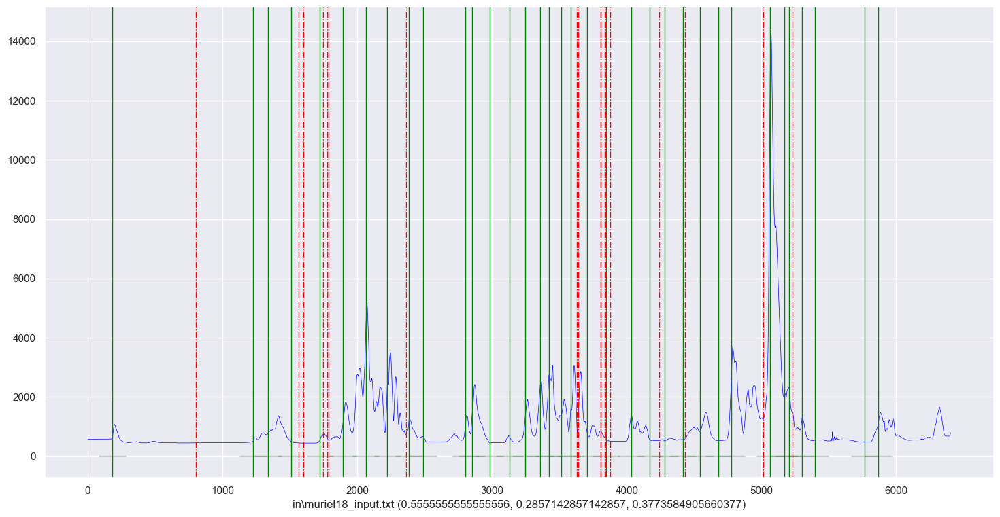

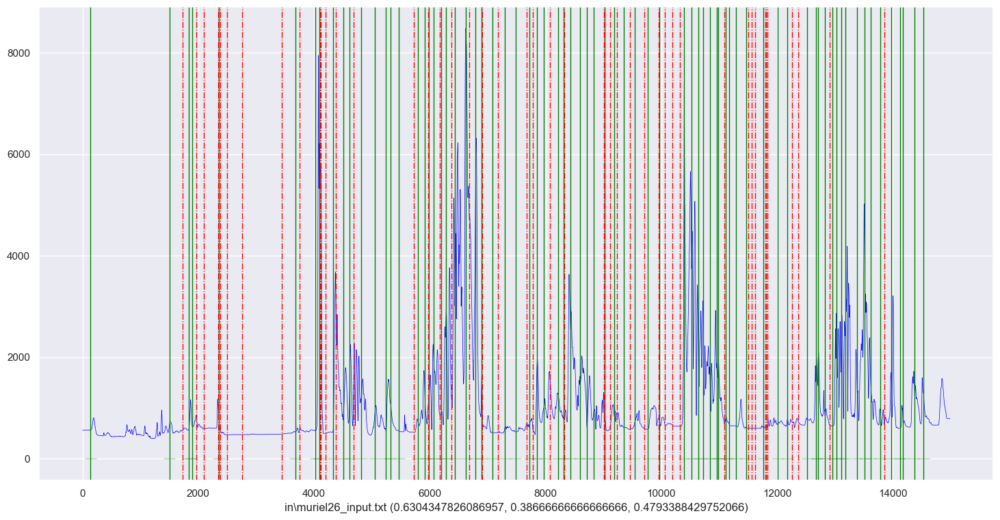

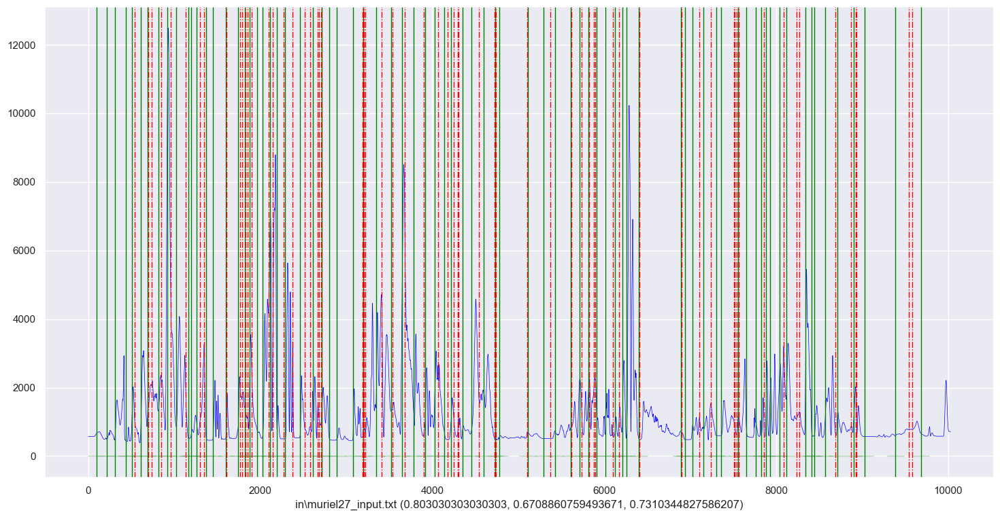

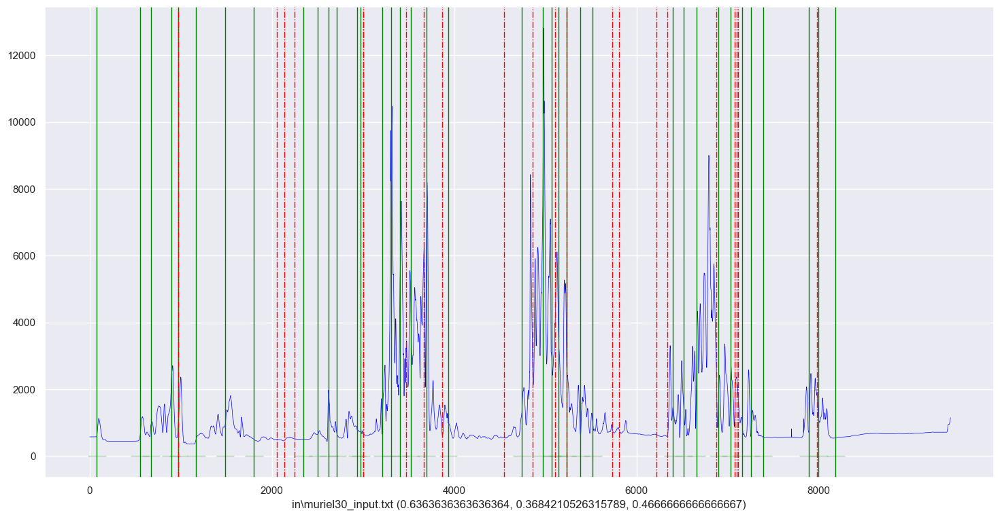

In [29]:
# fft
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="fft",n_segments=len(gt), validation=None)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"fft",timeseries[i])

0
f1margin: (0.1901840490797546, 0.96875, 0.31794871794871793)
1


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.25925925925925924, 0.875, 0.39999999999999997)
2
f1margin: (0.13008130081300814, 0.9411764705882353, 0.22857142857142856)
3


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.32894736842105265, 1.0, 0.4950495049504951)
4
f1margin: (0.38235294117647056, 0.6190476190476191, 0.4727272727272727)
5


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.6190476190476191, 0.9629629629629629, 0.7536231884057971)
6


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.6333333333333333, 0.7307692307692307, 0.6785714285714285)
7
f1margin: (0.7142857142857143, 0.5769230769230769, 0.6382978723404256)
8
f1margin: (0.40540540540540543, 1.0, 0.5769230769230769)
9
f1margin: (0.3181818181818182, 0.9545454545454546, 0.47727272727272724)
10
f1margin: (0.6896551724137931, 0.9523809523809523, 0.7999999999999999)
11


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.35294117647058826, 0.9230769230769231, 0.5106382978723405)
12


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\window_size.py:213: UserWarning: Could not find any autocorrelation peaks. Using window_size=10.
  warnings.warn(f"Could not find any autocorrelation peaks. Using window_size={lbound}.")


f1margin: (0.14754098360655737, 1.0, 0.2571428571428572)
13
f1margin: (0.20430107526881722, 0.9743589743589743, 0.33777777777777784)
14


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.7857142857142857, 0.6470588235294118, 0.7096774193548386)
15


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.48484848484848486, 0.9411764705882353, 0.64)
16
f1margin: (0.4305555555555556, 0.8857142857142857, 0.5794392523364487)
17
f1margin: (0.2568493150684932, 1.0, 0.40871934604904636)
18
f1margin: (0.430939226519337, 0.9873417721518988, 0.6000000000000001)
19
f1margin: (0.18627450980392157, 1.0, 0.3140495867768595)


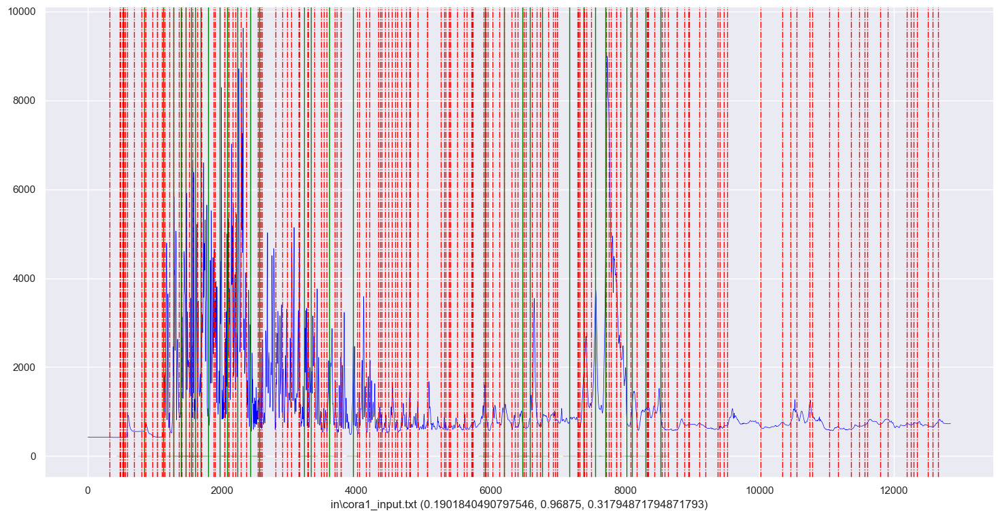

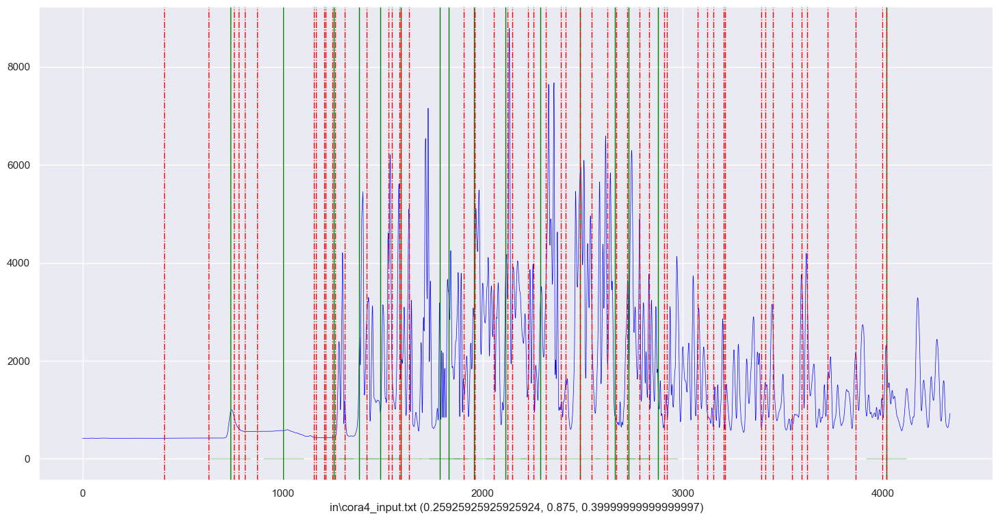

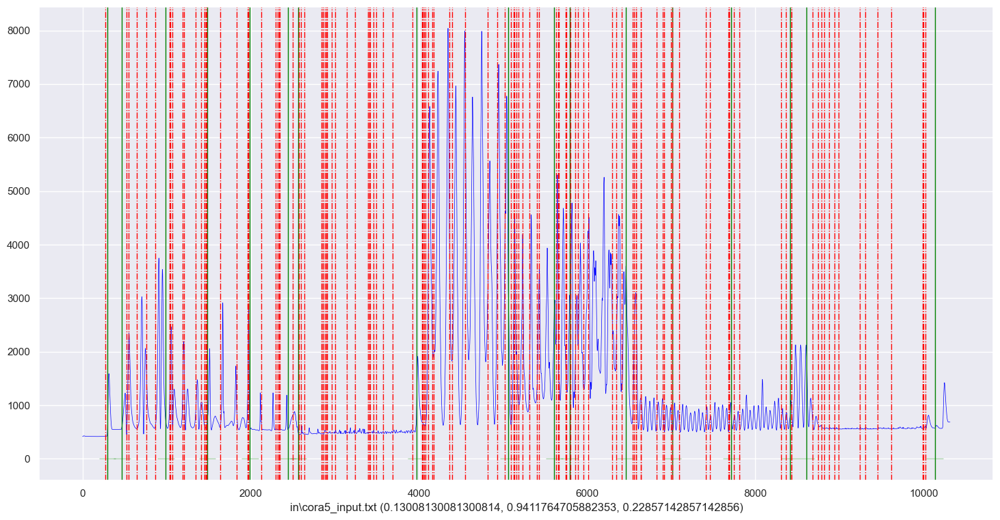

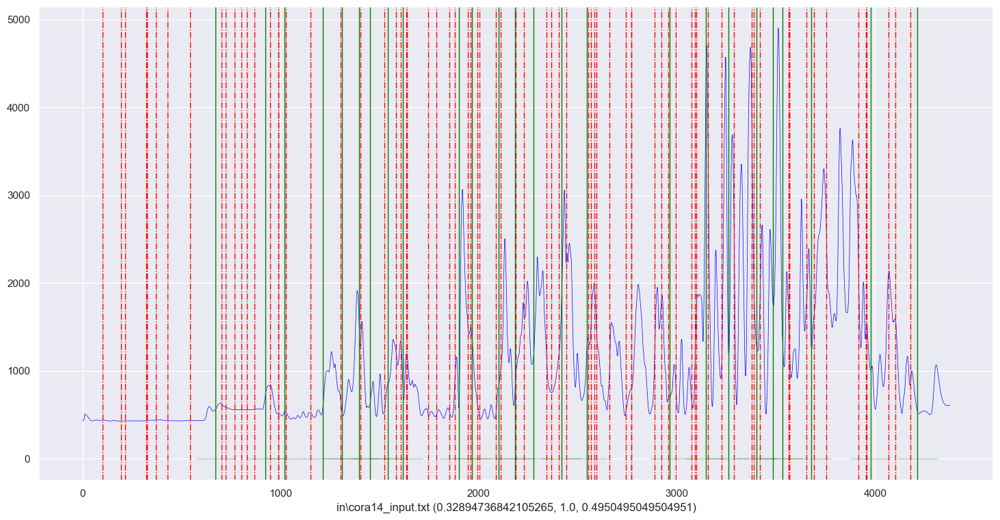

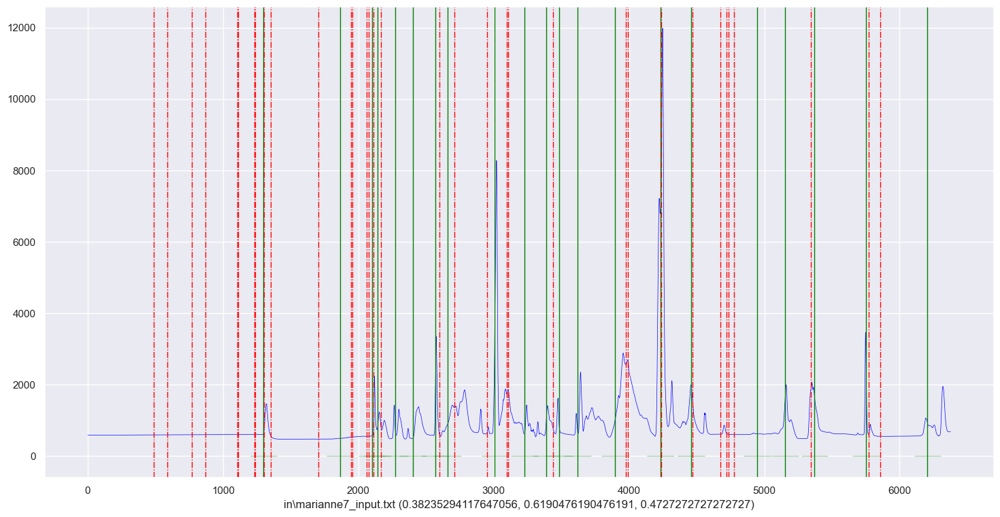

...

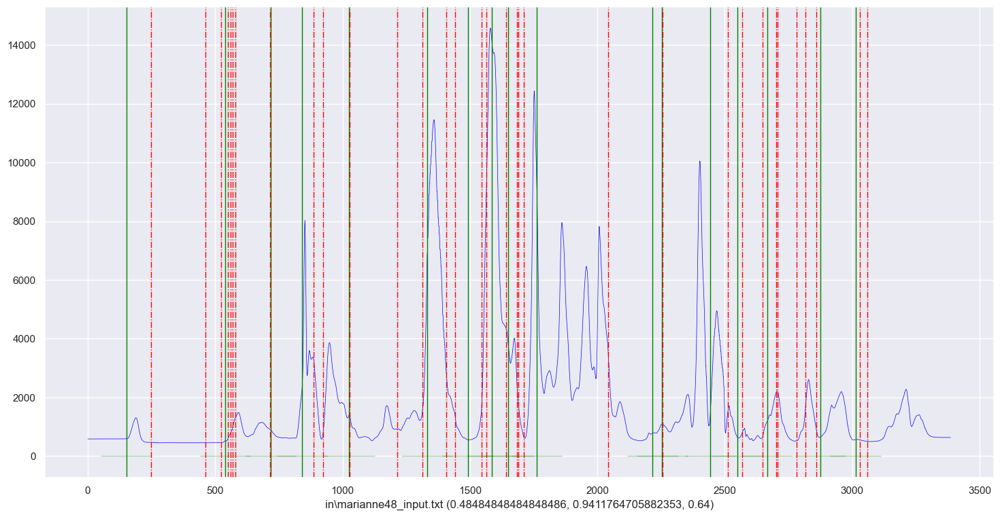

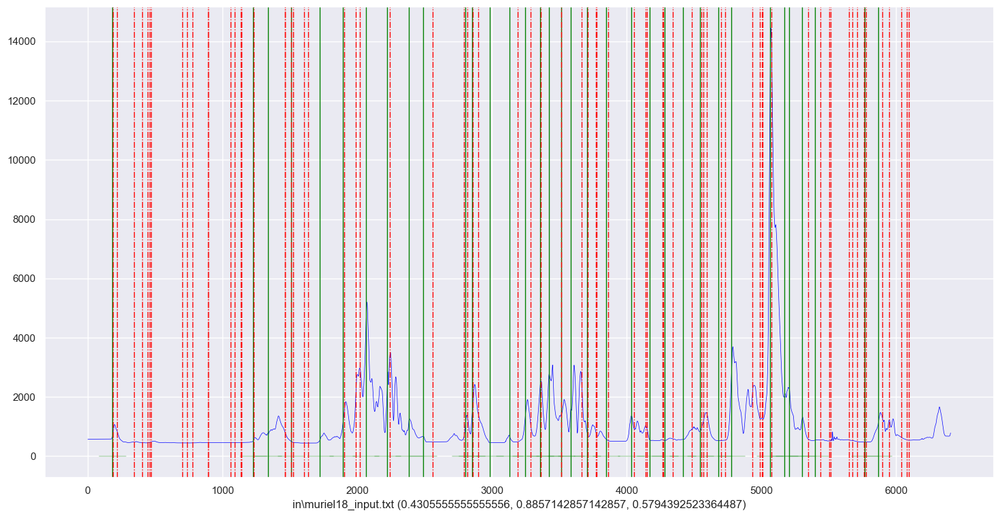

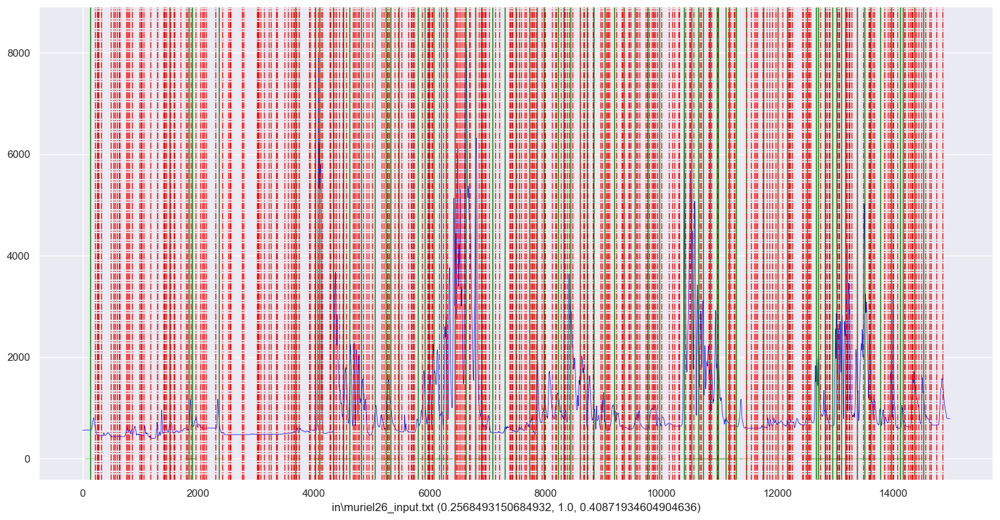

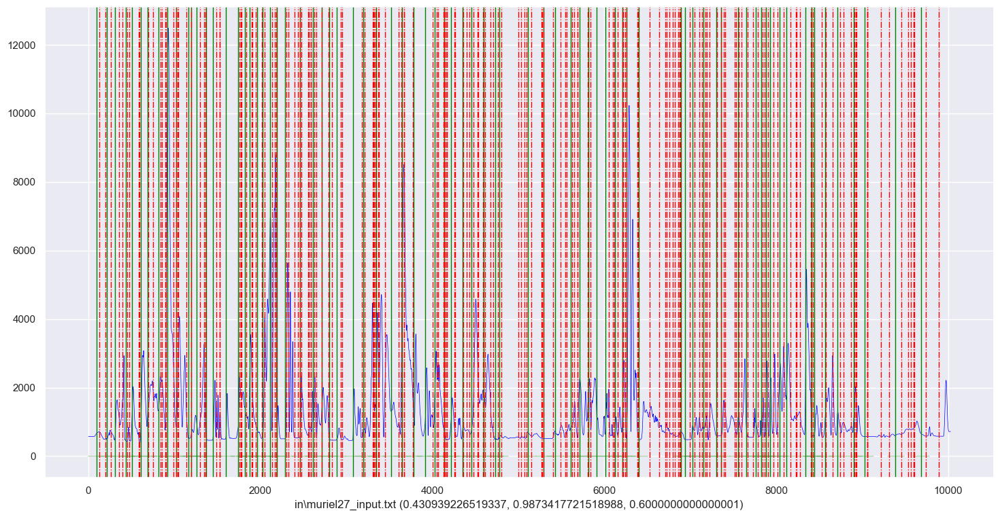

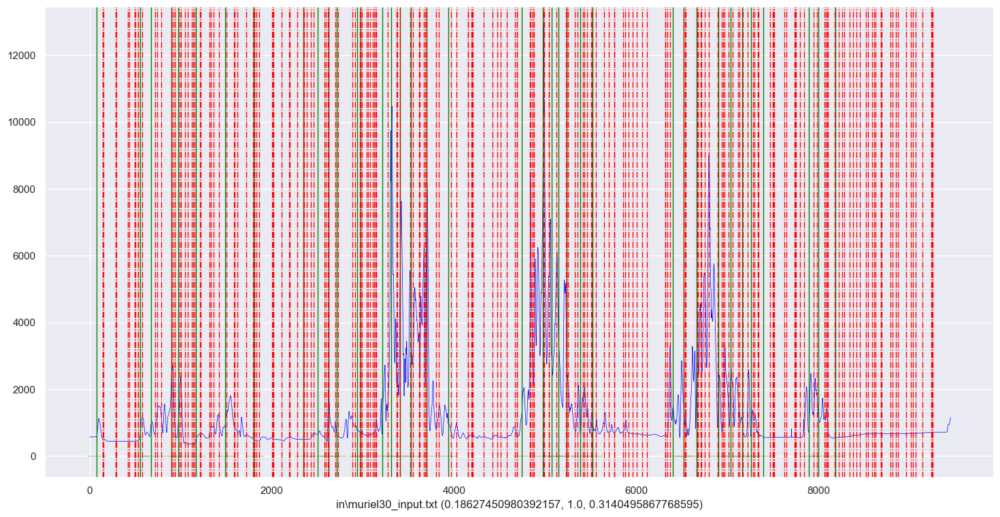

In [30]:
# acf
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="acf",n_segments=len(gt), validation=None)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"acf",timeseries[i])

0
f1margin: (0.1382488479262673, 0.9375, 0.24096385542168675)
1
f1margin: (0.20253164556962025, 1.0, 0.3368421052631579)
2
f1margin: (0.11940298507462686, 0.9411764705882353, 0.21192052980132453)
3
f1margin: (0.3770491803278688, 0.92, 0.5348837209302325)
4
f1margin: (0.18518518518518517, 0.9523809523809523, 0.31007751937984496)
5
f1margin: (0.40625, 0.9629629629629629, 0.5714285714285714)
6
f1margin: (0.5, 1.0, 0.6666666666666666)
7
f1margin: (0.28888888888888886, 1.0, 0.4482758620689655)
8
f1margin: (0.5540540540540541, 0.9111111111111111, 0.6890756302521008)
9
f1margin: (0.19607843137254902, 0.9090909090909091, 0.3225806451612903)
10
f1margin: (0.4186046511627907, 0.8571428571428571, 0.5625000000000001)
11
f1margin: (0.2033898305084746, 0.9230769230769231, 0.3333333333333333)
12
f1margin: (0.11267605633802817, 0.8888888888888888, 0.2)
13
f1margin: (0.20441988950276244, 0.9487179487179487, 0.33636363636363636)
14
f1margin: (0.5161290322580645, 0.9411764705882353, 0.6666666666666666)
1

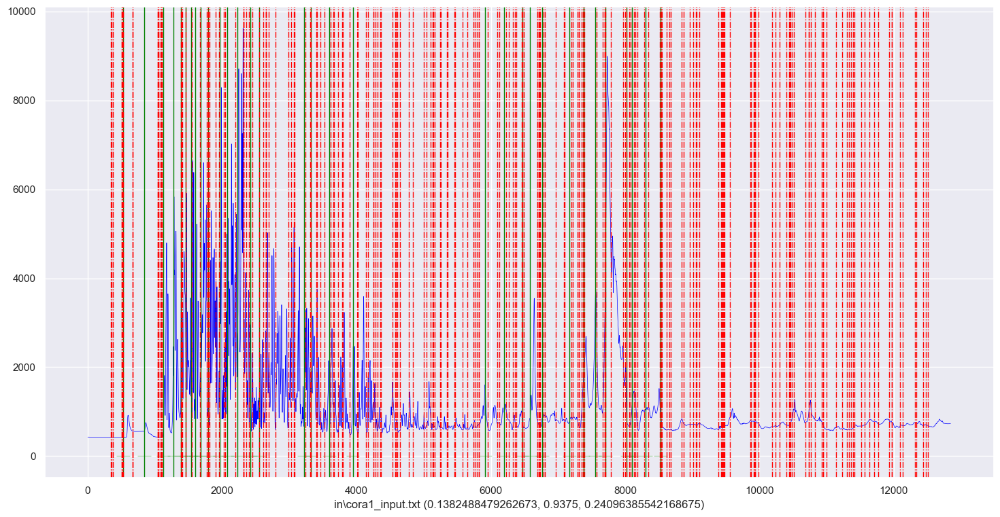

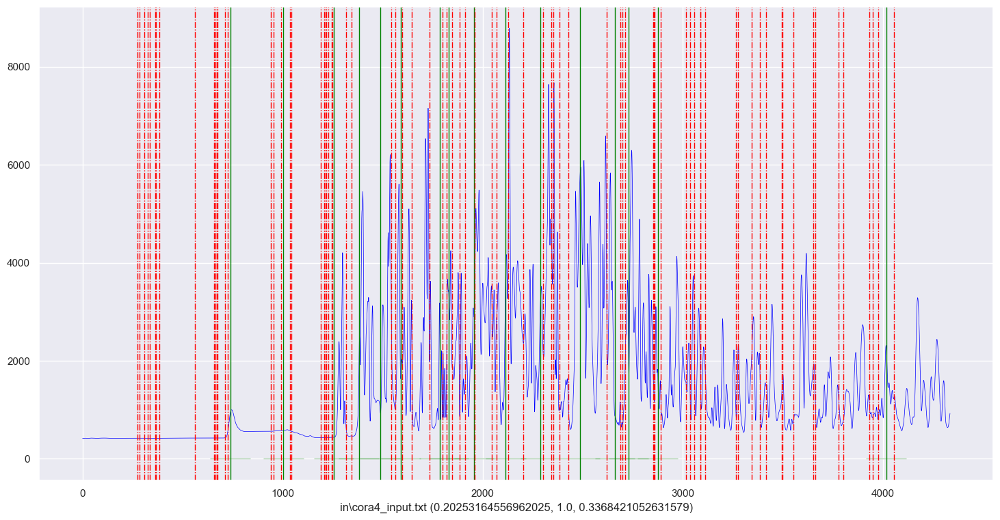

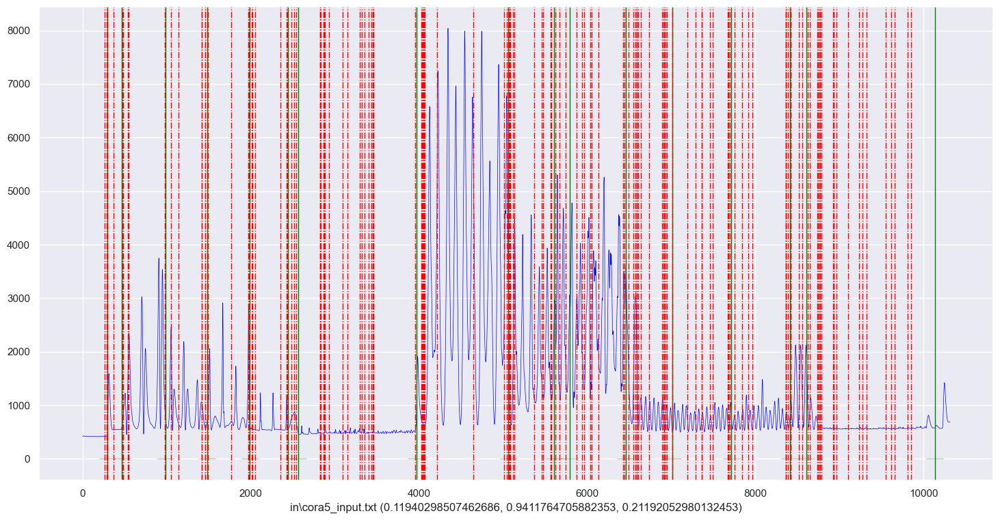

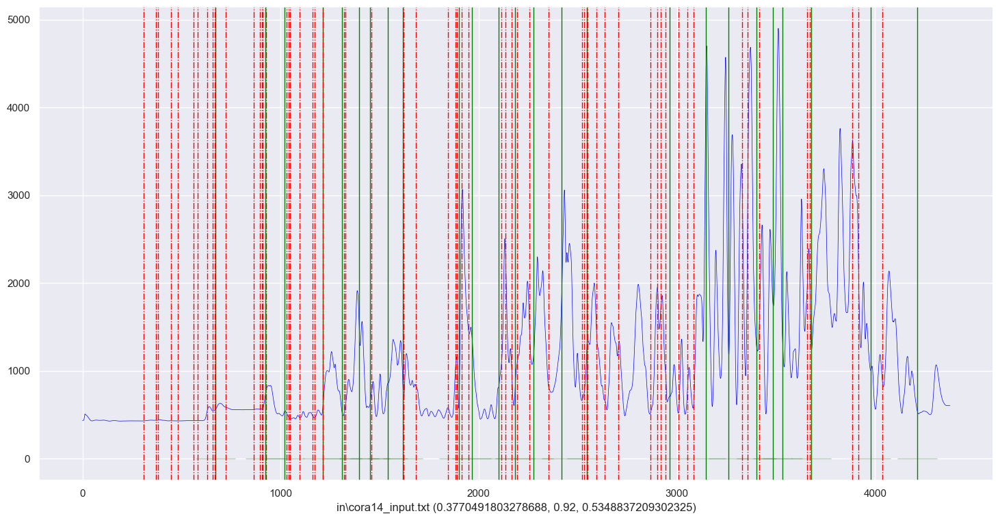

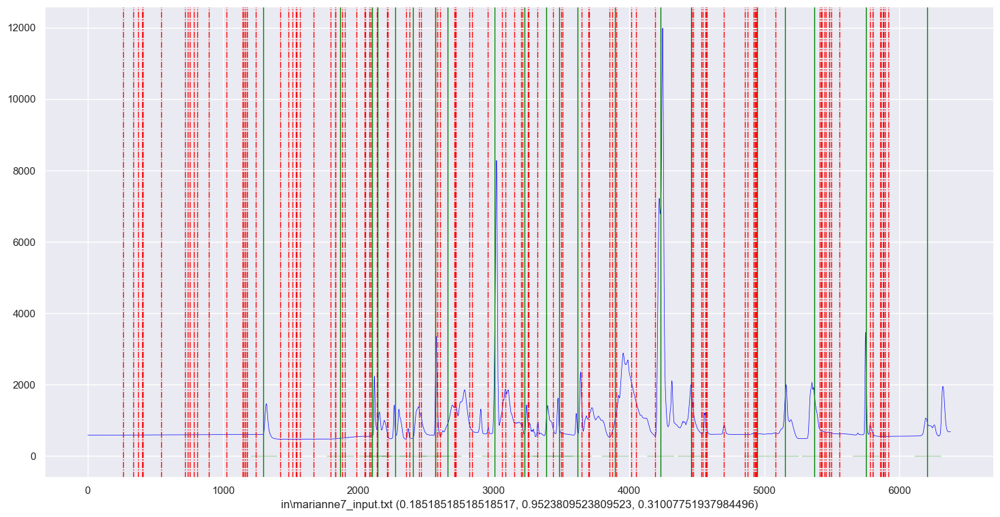

...

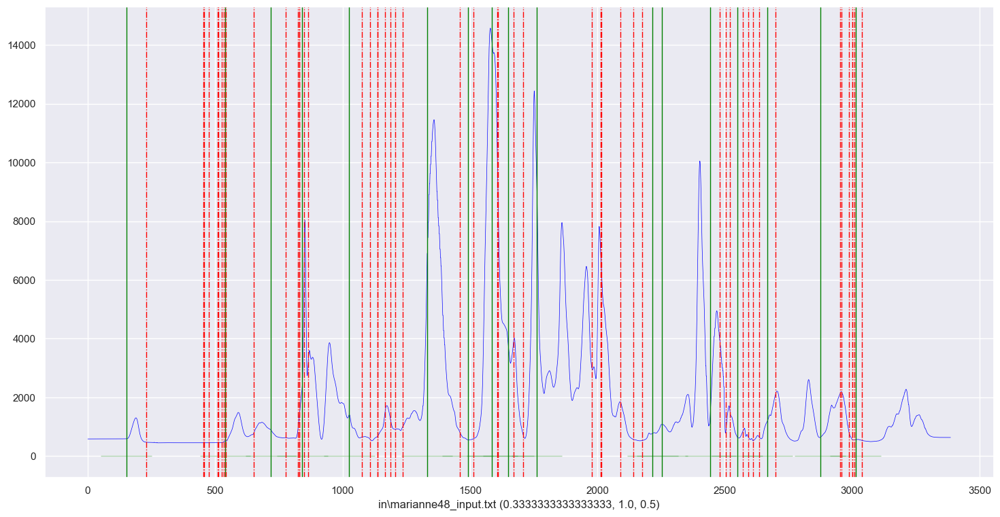

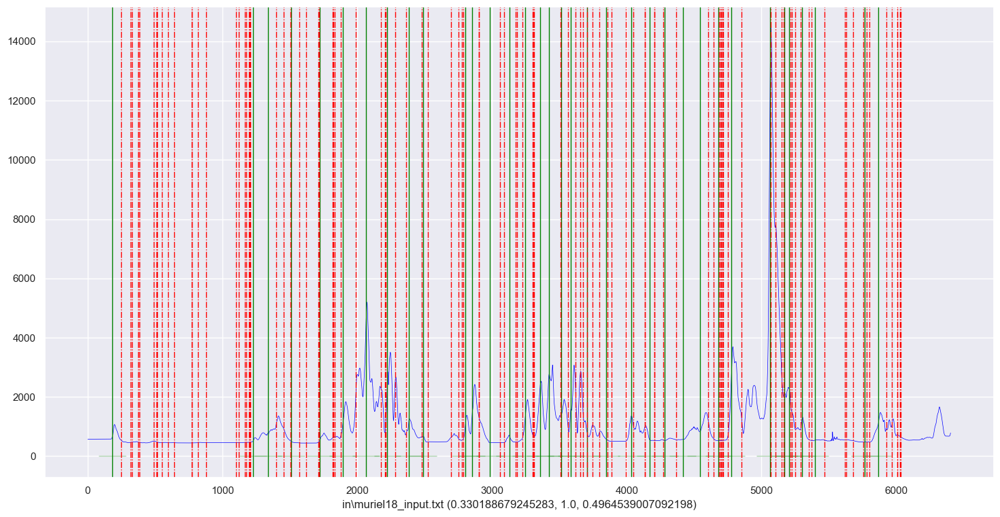

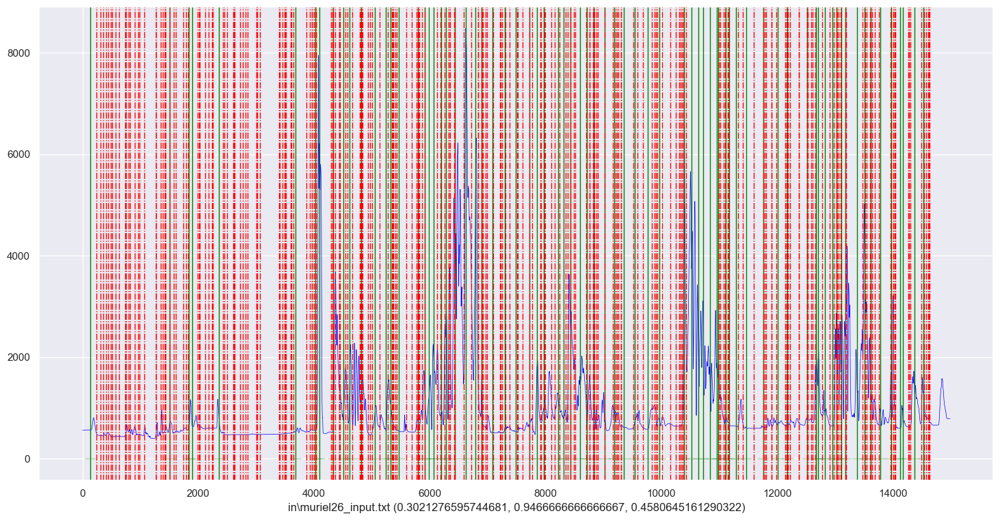

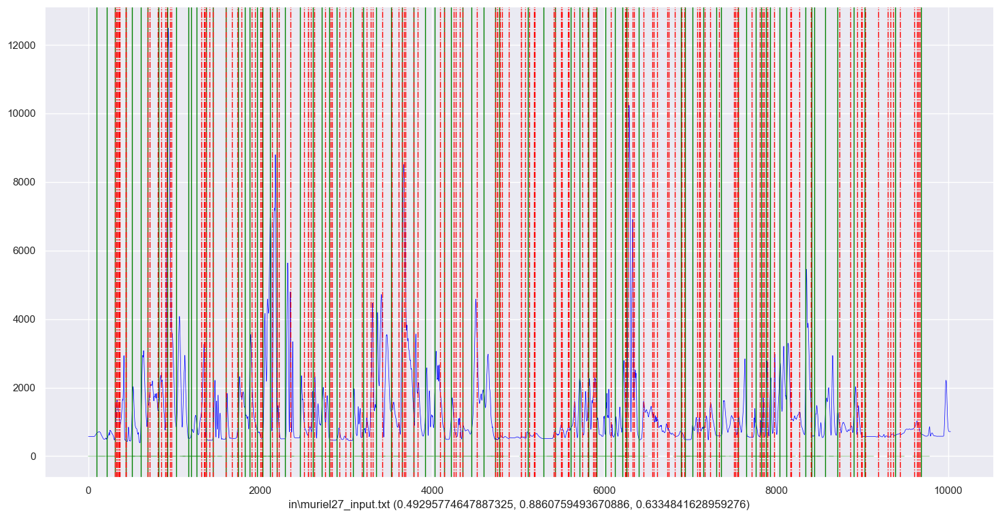

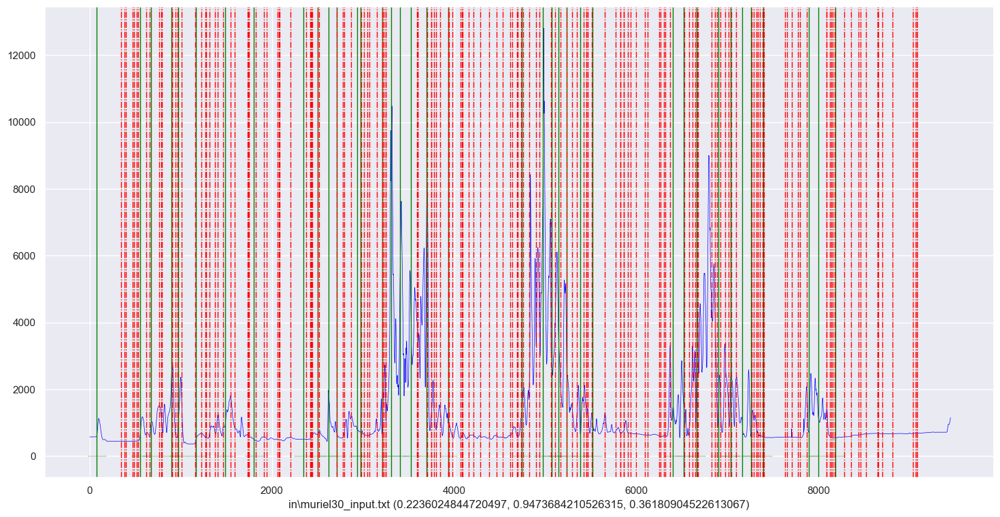

In [31]:
# suss, euclidean
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="suss", distance="euclidean_distance",n_segments=len(gt), validation=None)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"suss euclidean",timeseries[i])

0
f1margin: (0.3, 0.5625, 0.3913043478260869)
1
f1margin: (0.3409090909090909, 0.9375, 0.5)
2
f1margin: (0.16666666666666666, 1.0, 0.2857142857142857)
3
f1margin: (0.5128205128205128, 0.8, 0.625)
4
f1margin: (0.37209302325581395, 0.7619047619047619, 0.5)
5
f1margin: (0.8095238095238095, 0.6296296296296297, 0.7083333333333334)
6


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.8333333333333334, 0.38461538461538464, 0.5263157894736842)
7
f1margin: (0.5172413793103449, 0.5769230769230769, 0.5454545454545454)
8
f1margin: (0.8709677419354839, 0.6, 0.7105263157894737)
9
f1margin: (0.36363636363636365, 0.5454545454545454, 0.43636363636363634)
10


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.8461538461538461, 0.5238095238095238, 0.6470588235294118)
11
f1margin: (0.4, 0.46153846153846156, 0.42857142857142855)
12
f1margin: (0.06060606060606061, 0.2222222222222222, 0.09523809523809523)
13
f1margin: (0.35064935064935066, 0.6923076923076923, 0.46551724137931033)
14


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.75, 0.7058823529411765, 0.7272727272727272)
15


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.42857142857142855, 0.8823529411764706, 0.5769230769230769)
16
f1margin: (0.7142857142857143, 0.2857142857142857, 0.40816326530612246)
17
f1margin: (0.6458333333333334, 0.41333333333333333, 0.5040650406504066)
18
f1margin: (0.8548387096774194, 0.6708860759493671, 0.7517730496453902)
19
f1margin: (0.6153846153846154, 0.42105263157894735, 0.5)


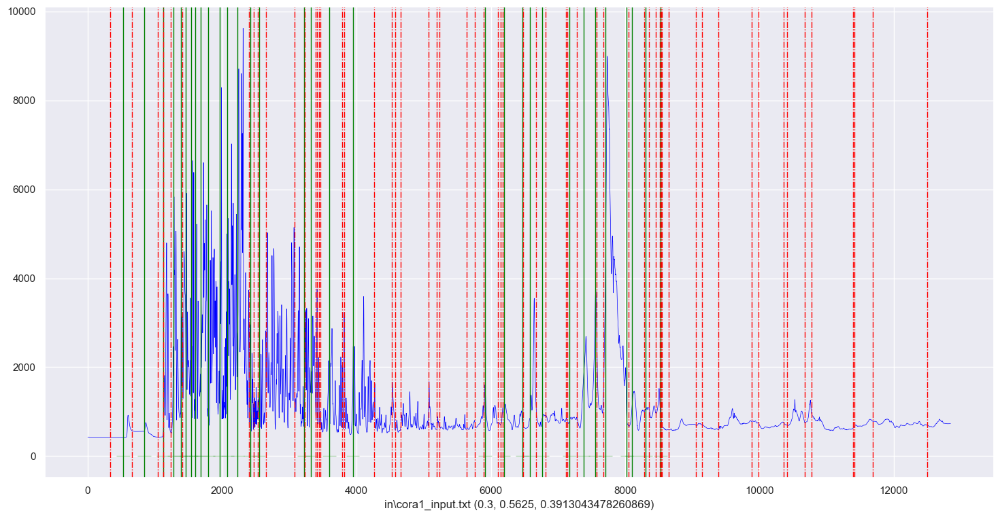

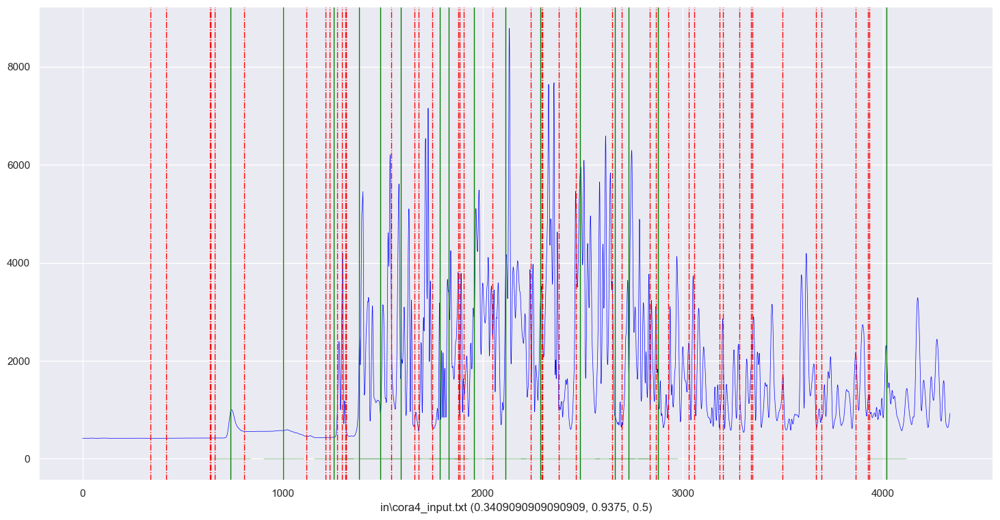

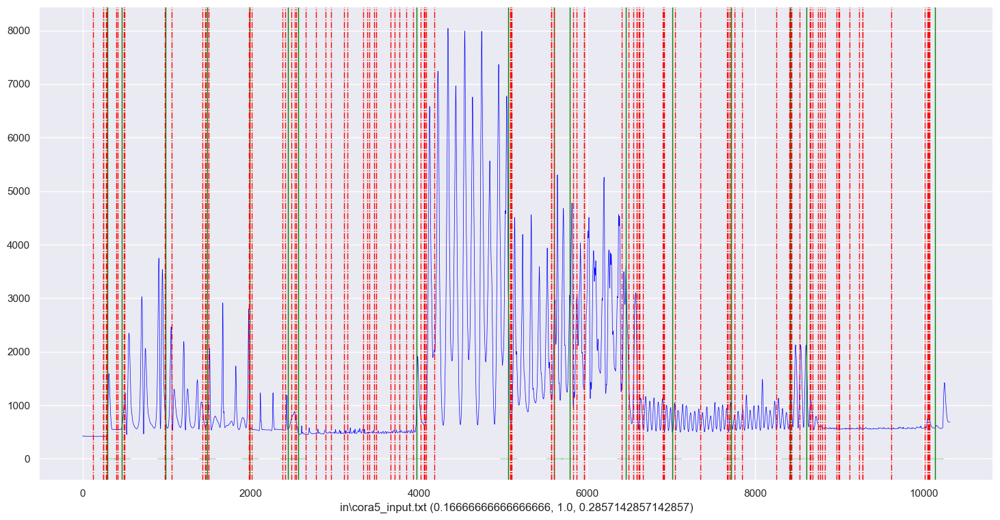

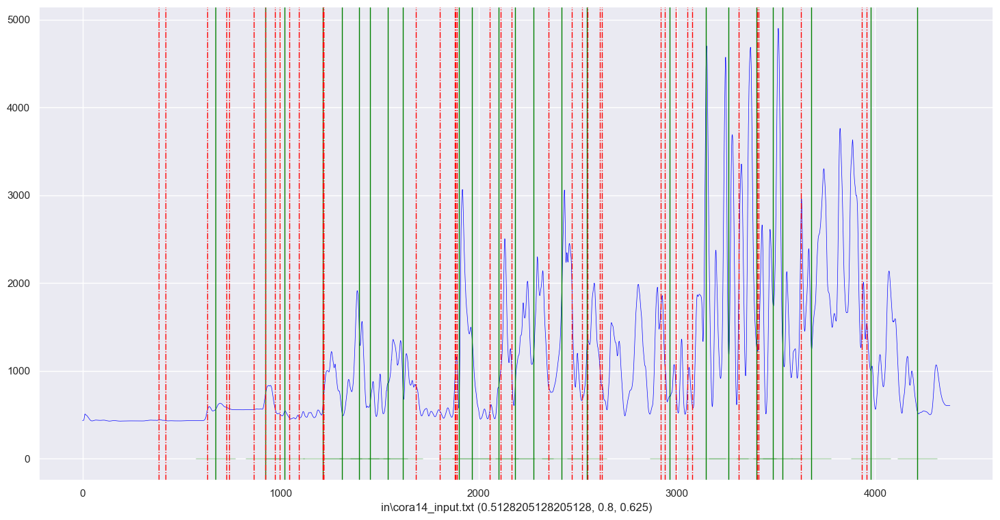

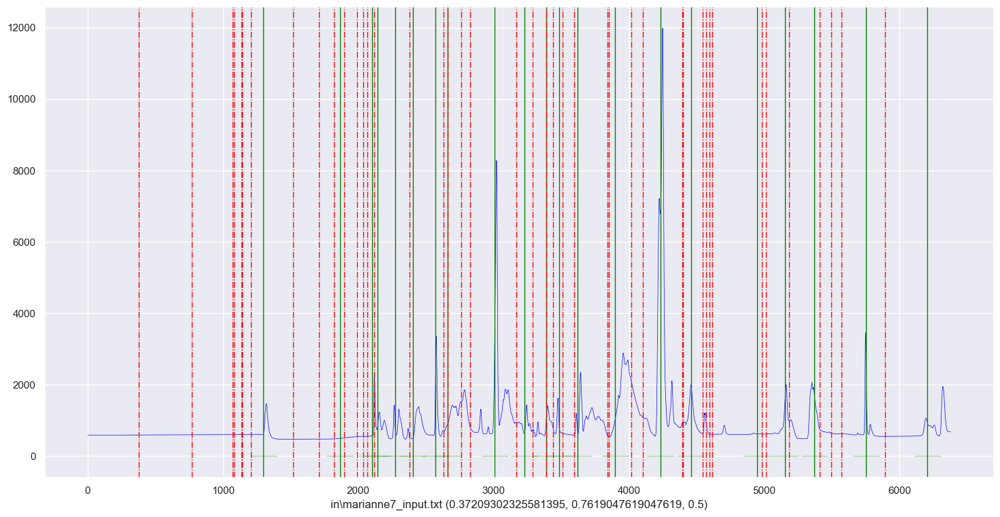

...

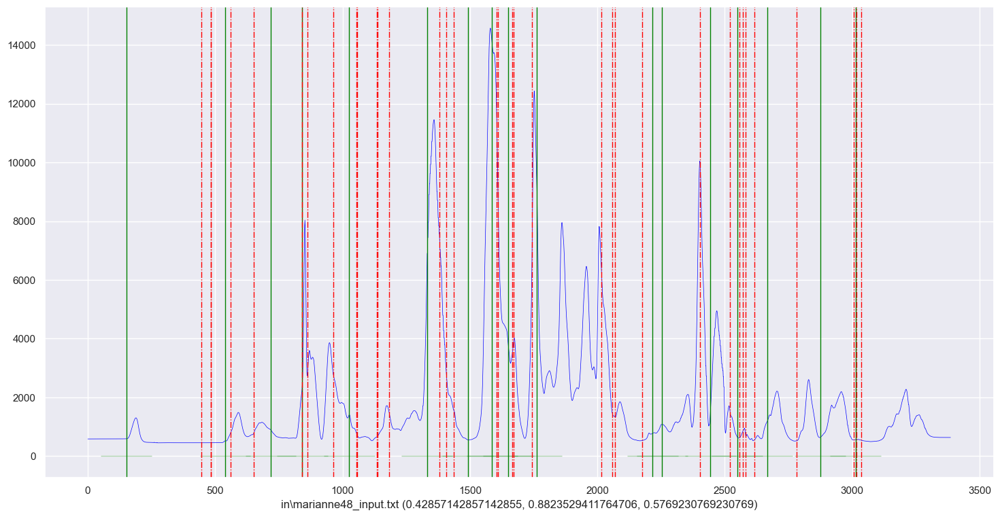

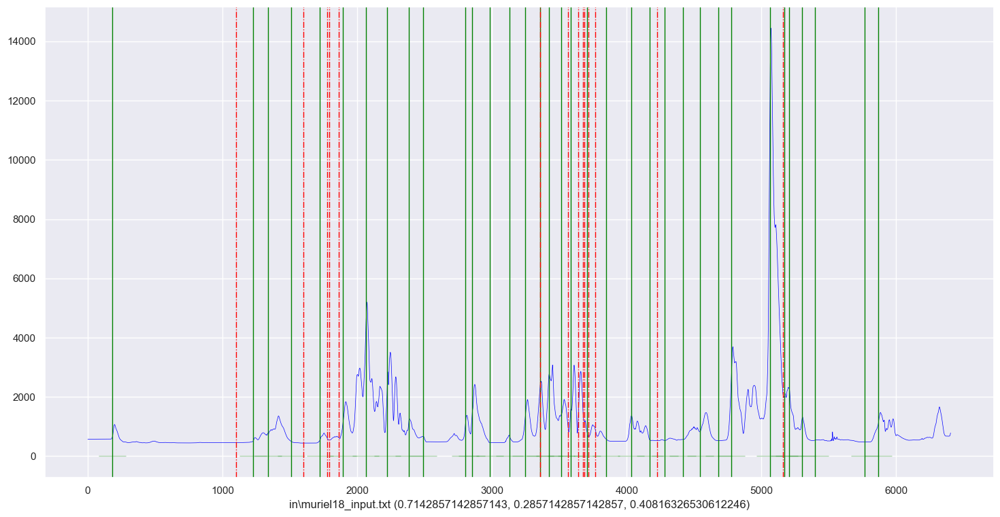

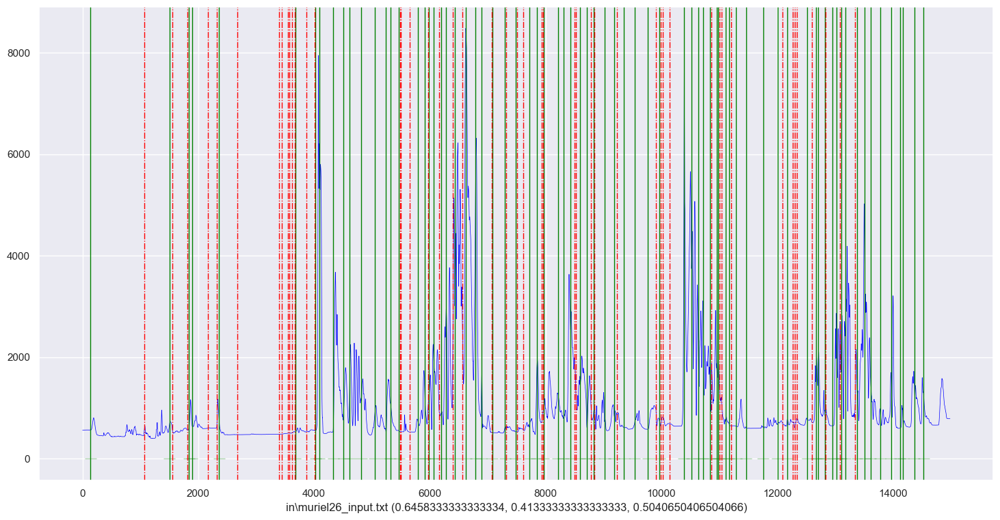

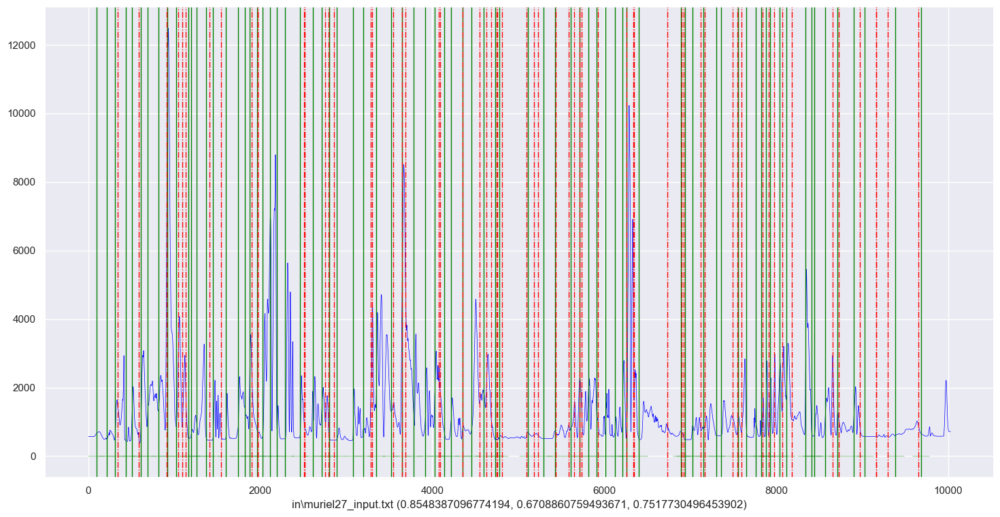

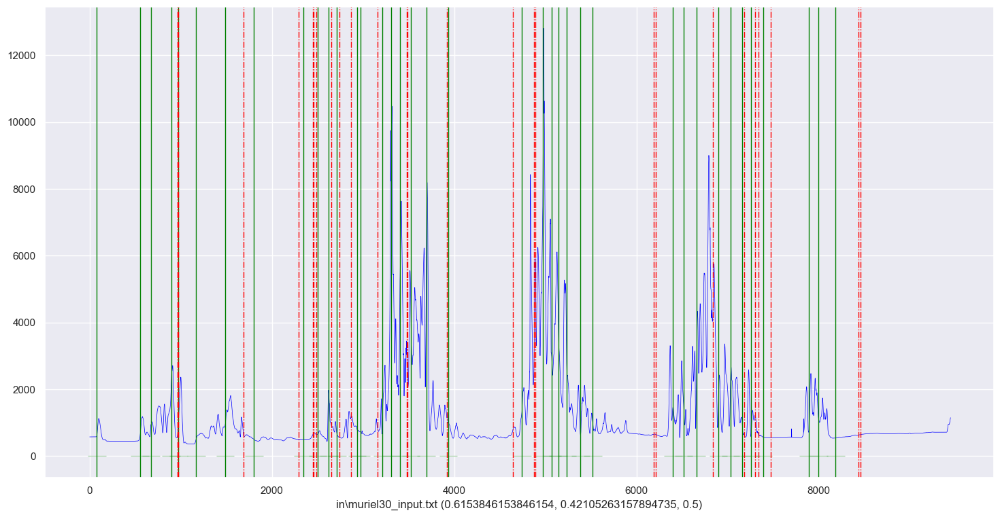

In [32]:
# fft, euclidean
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="fft", distance="euclidean_distance",n_segments=len(gt), validation=None)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"fft euclidean",timeseries[i])

0
f1margin: (0.16666666666666666, 0.9375, 0.2830188679245283)
1


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.2830188679245283, 0.9375, 0.4347826086956522)
2
f1margin: (0.12686567164179105, 1.0, 0.2251655629139073)
3


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.3424657534246575, 1.0, 0.5102040816326531)
4
f1margin: (0.3617021276595745, 0.8095238095238095, 0.5)
5


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.5714285714285714, 0.8888888888888888, 0.6956521739130435)
6


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.6551724137931034, 0.7307692307692307, 0.6909090909090909)
7
f1margin: (0.75, 0.34615384615384615, 0.4736842105263157)
8
f1margin: (0.3237410071942446, 1.0, 0.4891304347826087)
9
f1margin: (0.3230769230769231, 0.9545454545454546, 0.4827586206896552)
10
f1margin: (0.8333333333333334, 0.47619047619047616, 0.6060606060606061)
11


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.3793103448275862, 0.8461538461538461, 0.5238095238095238)
12


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\window_size.py:213: UserWarning: Could not find any autocorrelation peaks. Using window_size=10.
  warnings.warn(f"Could not find any autocorrelation peaks. Using window_size={lbound}.")


f1margin: (0.1875, 1.0, 0.3157894736842105)
13
f1margin: (0.1778846153846154, 0.9487179487179487, 0.29959514170040485)
14


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.8, 0.9411764705882353, 0.8648648648648648)
15


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.4375, 0.8235294117647058, 0.5714285714285714)
16
f1margin: (0.38823529411764707, 0.9428571428571428, 0.55)
17
f1margin: (0.24834437086092714, 1.0, 0.3978779840848806)
18
f1margin: (0.4838709677419355, 0.9493670886075949, 0.641025641025641)
19
f1margin: (0.19095477386934673, 1.0, 0.3206751054852321)


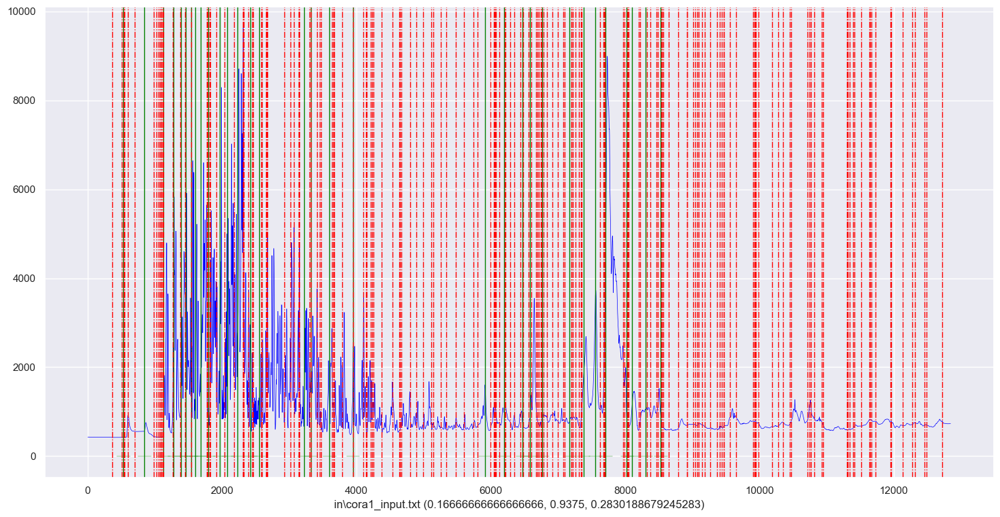

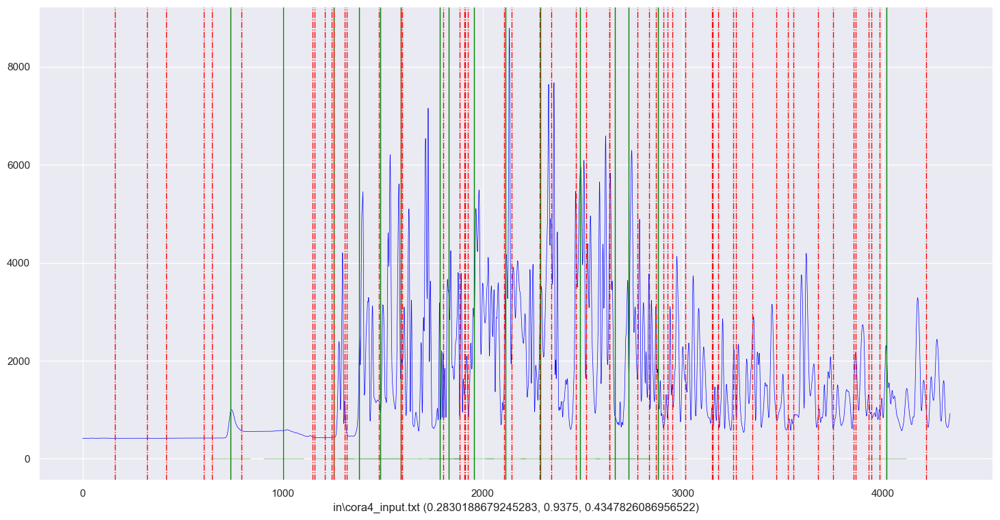

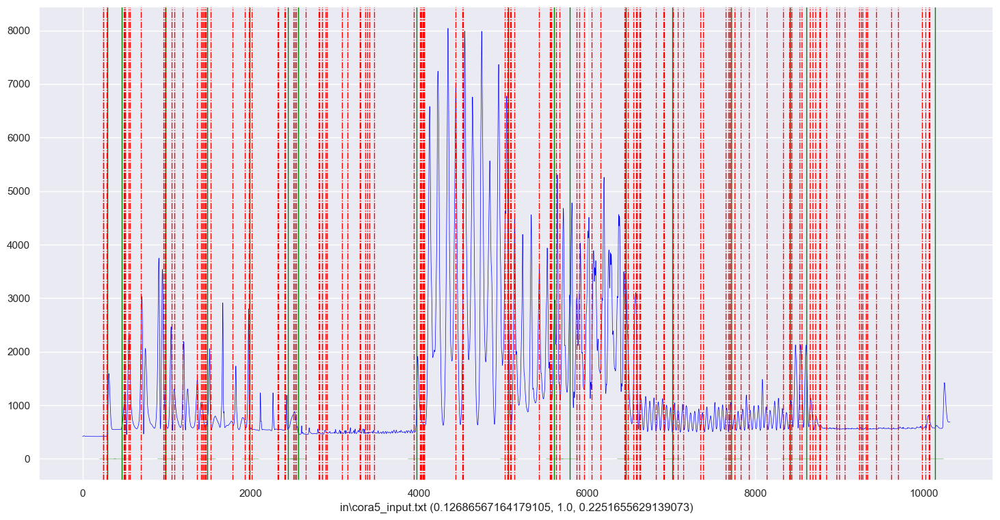

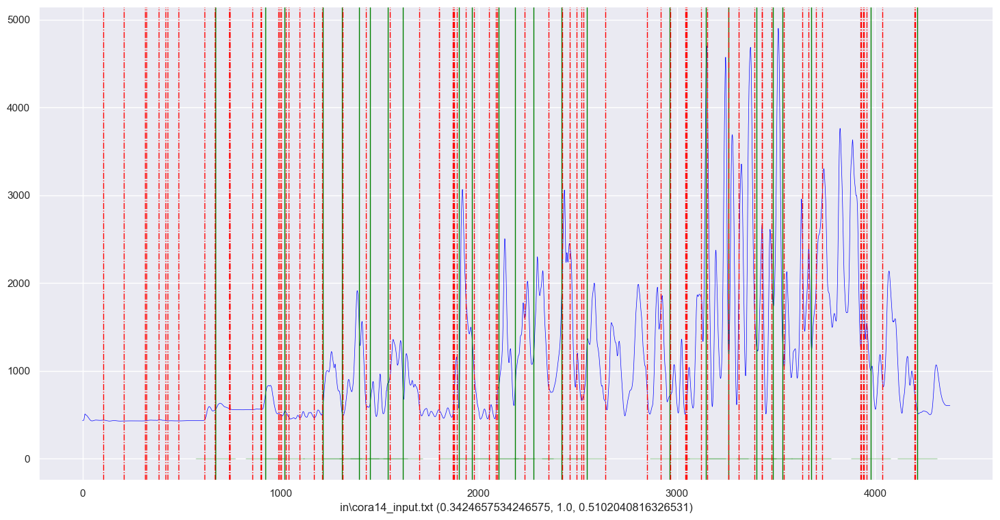

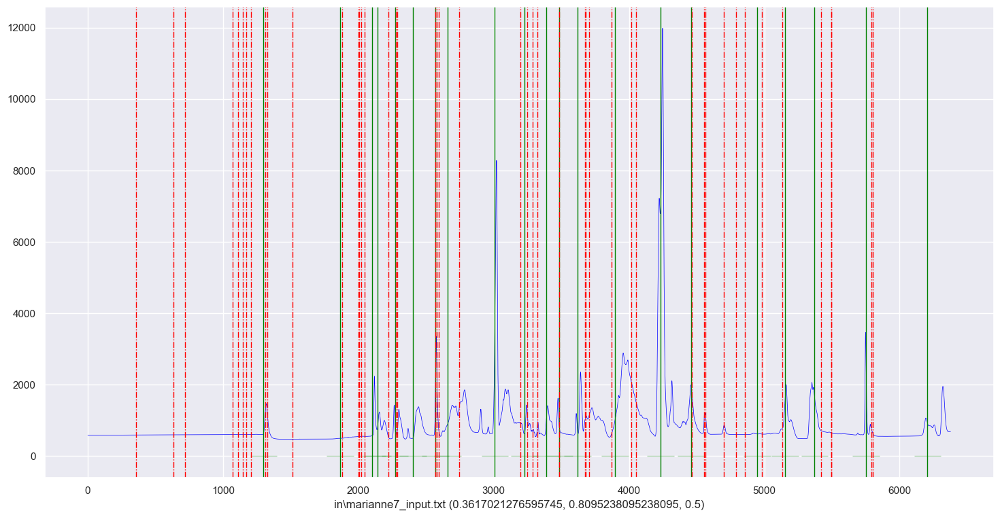

...

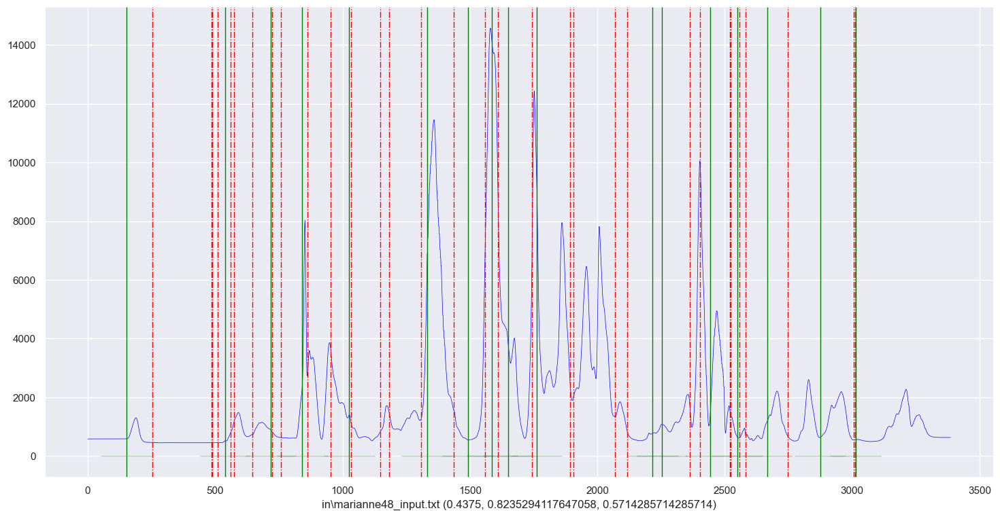

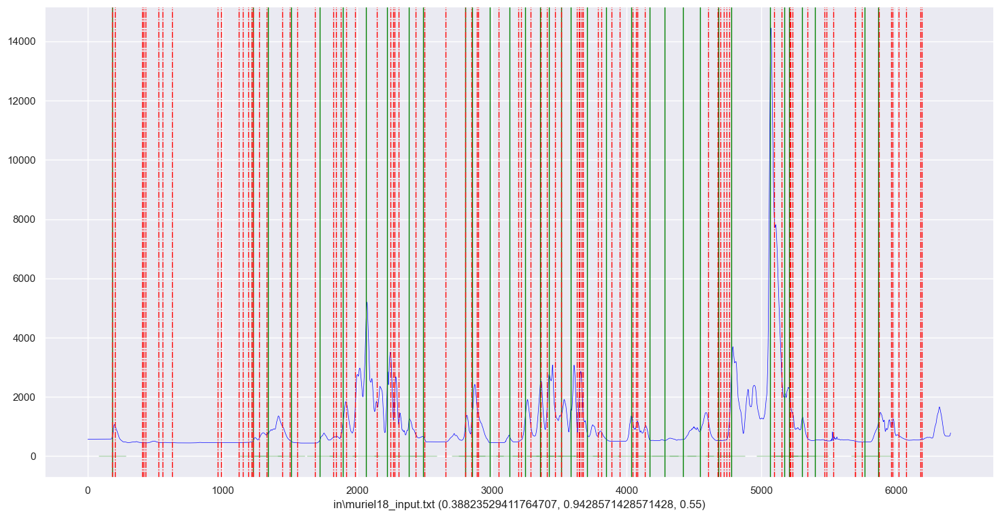

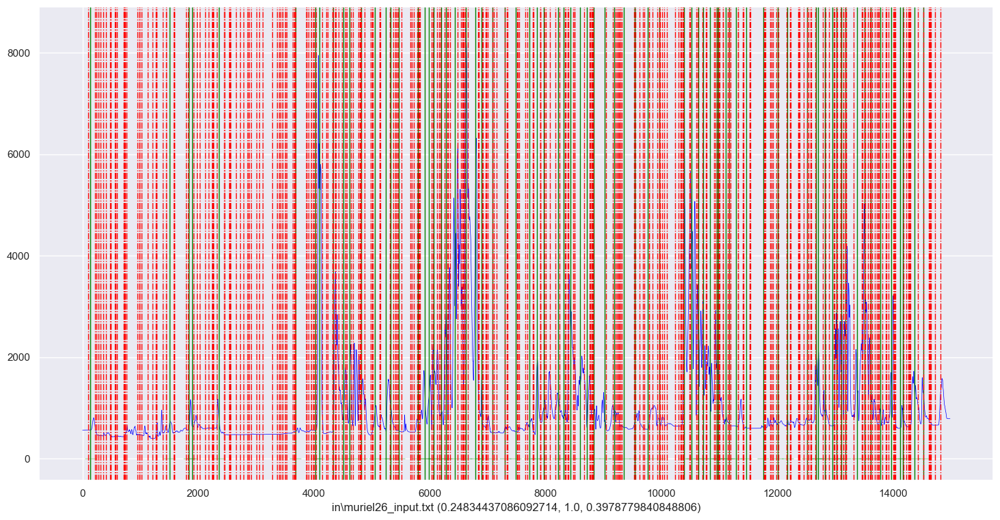

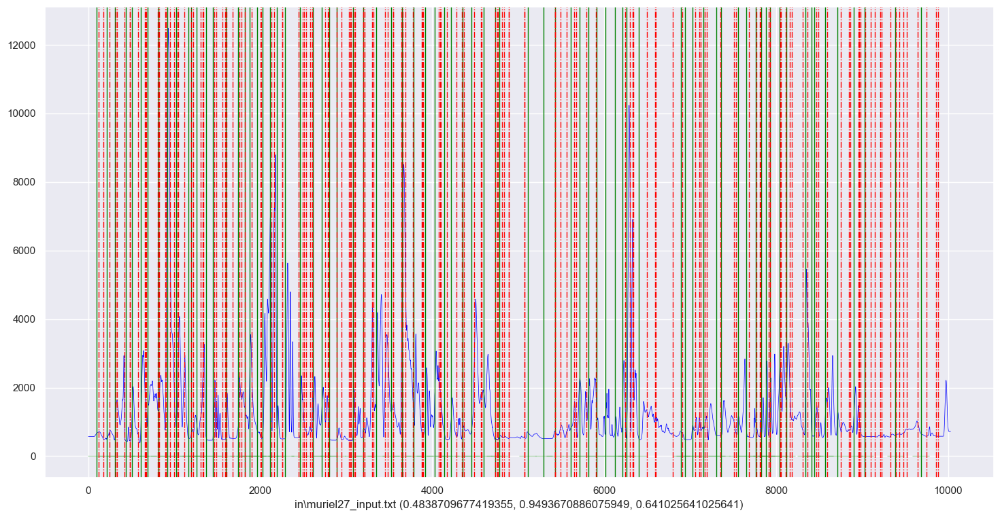

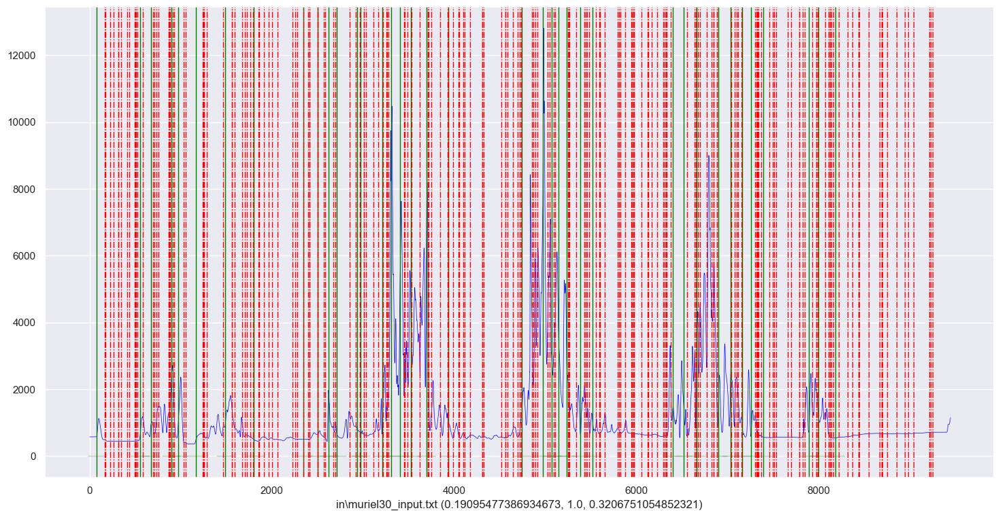

In [33]:
# acf, euclidean
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="acf", distance="euclidean_distance",n_segments=len(gt), validation=None)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"acf euclidean",timeseries[i])

0
f1margin: (0.128, 1.0, 0.22695035460992907)
1
f1margin: (0.16, 1.0, 0.2758620689655173)
2
f1margin: (0.1223021582733813, 1.0, 0.21794871794871798)
3
f1margin: (0.26881720430107525, 1.0, 0.423728813559322)
4
f1margin: (0.15748031496062992, 0.9523809523809523, 0.2702702702702703)
5
f1margin: (0.39705882352941174, 1.0, 0.5684210526315789)
6
f1margin: (0.34210526315789475, 1.0, 0.5098039215686275)
7
f1margin: (0.2524271844660194, 1.0, 0.4031007751937985)
8
f1margin: (0.39473684210526316, 1.0, 0.5660377358490566)
9
f1margin: (0.17699115044247787, 0.9090909090909091, 0.29629629629629634)
10
f1margin: (0.4375, 1.0, 0.6086956521739131)
11
f1margin: (0.1875, 0.9230769230769231, 0.3116883116883117)
12
f1margin: (0.11428571428571428, 0.8888888888888888, 0.20253164556962022)
13
f1margin: (0.15447154471544716, 0.9743589743589743, 0.26666666666666666)
14
f1margin: (0.3695652173913043, 1.0, 0.5396825396825397)
15
f1margin: (0.26153846153846155, 1.0, 0.41463414634146345)
16
f1margin: (0.282258064516

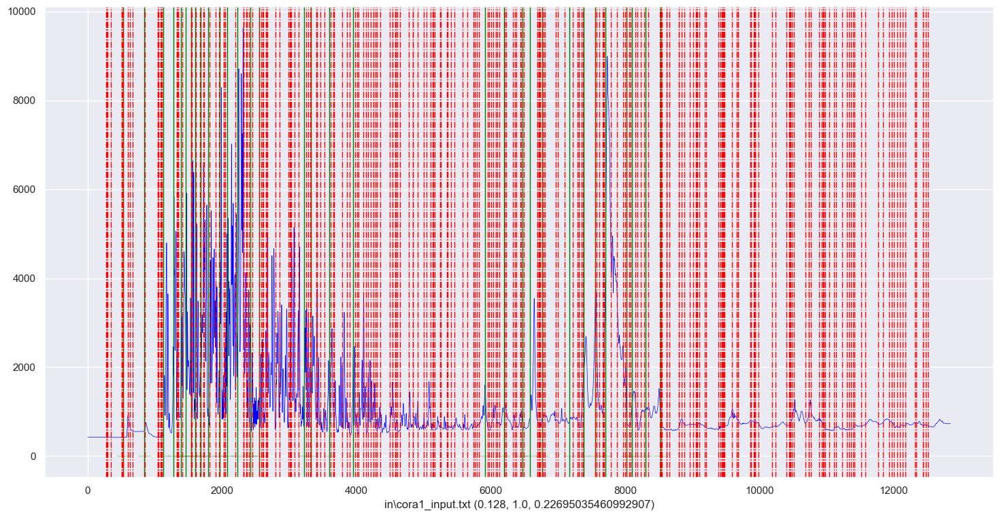

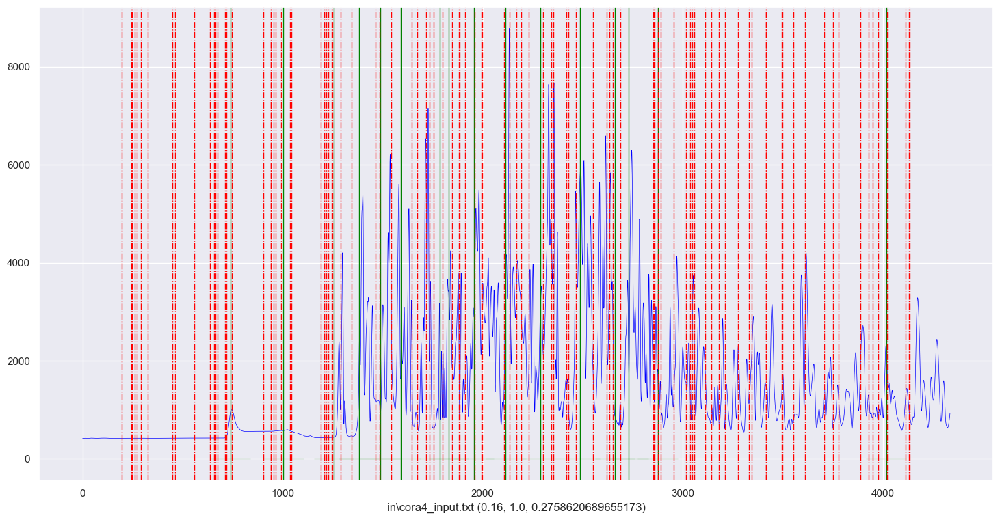

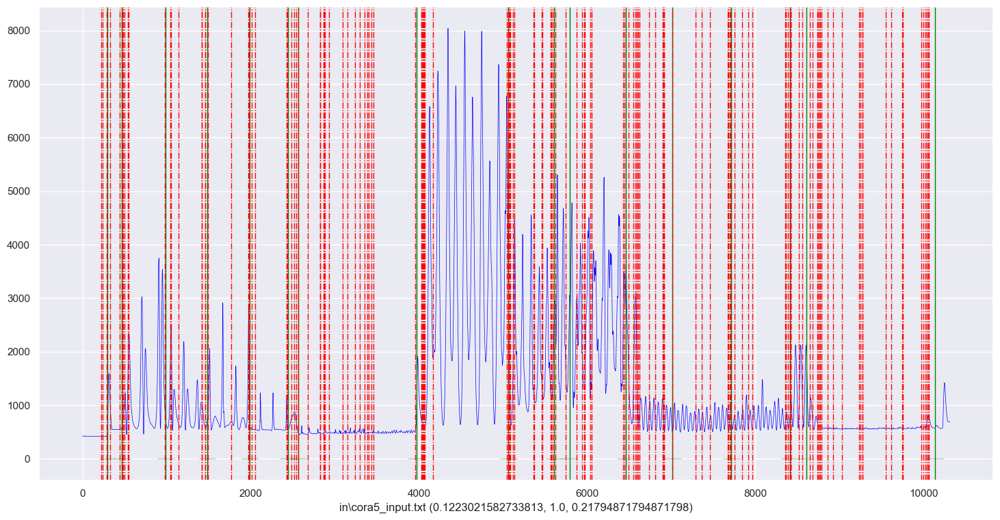

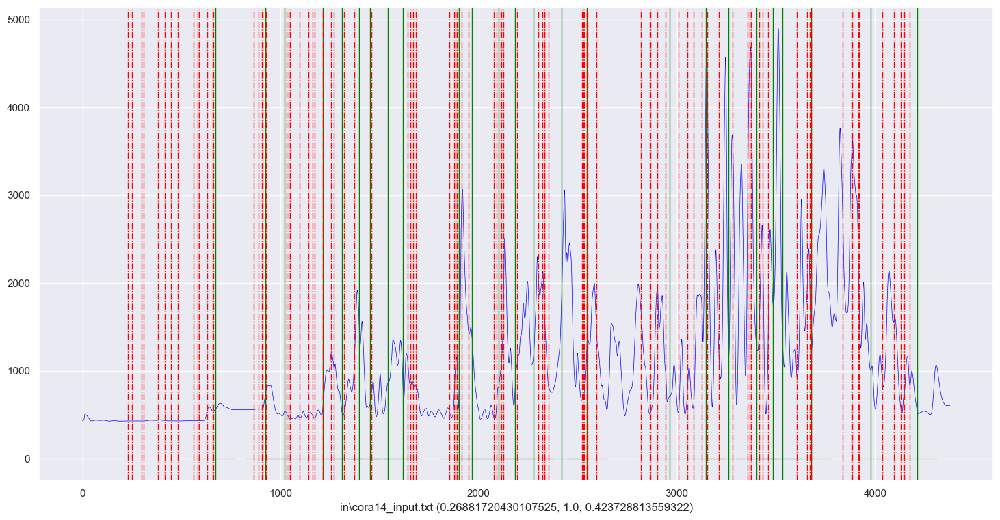

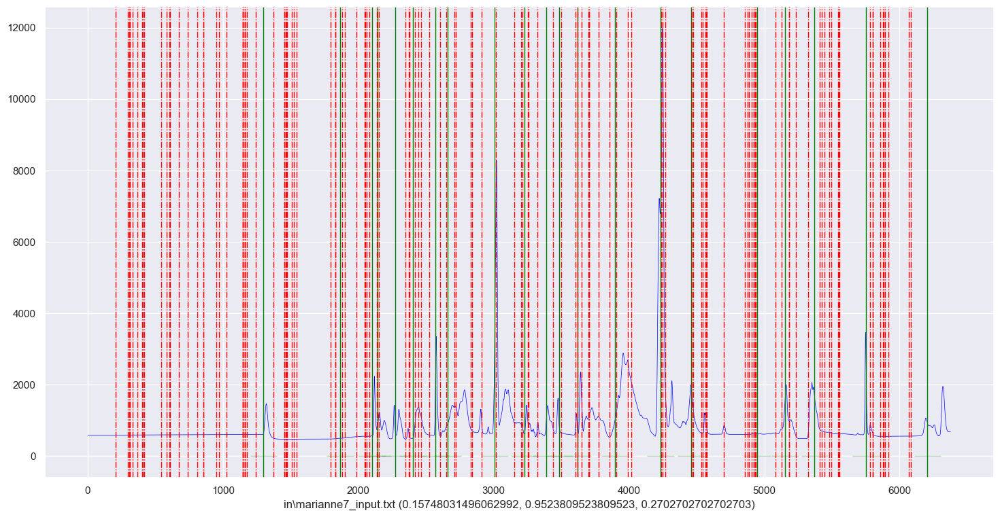

...

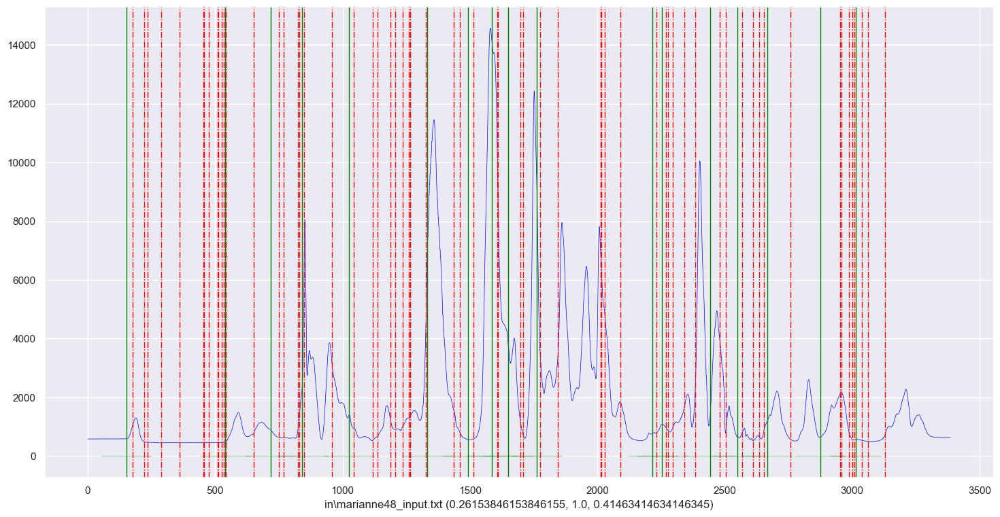

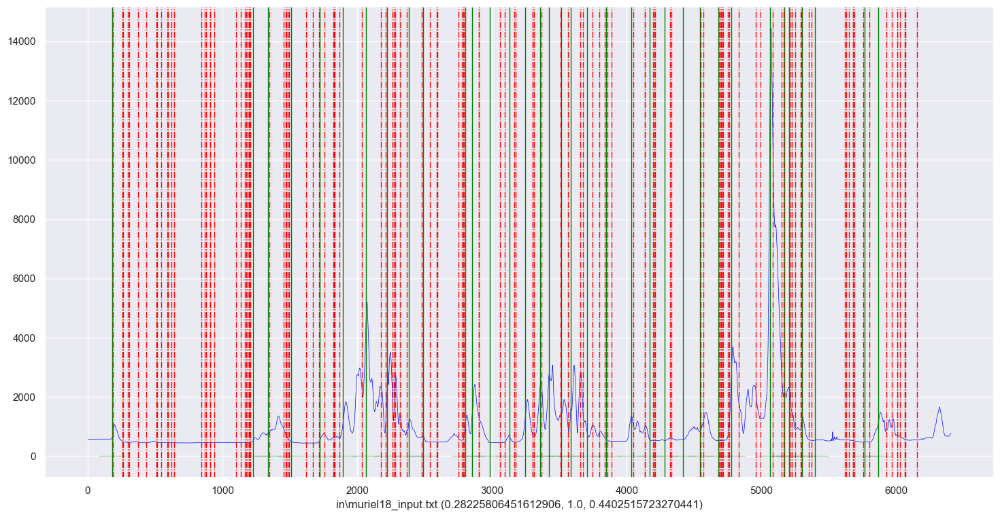

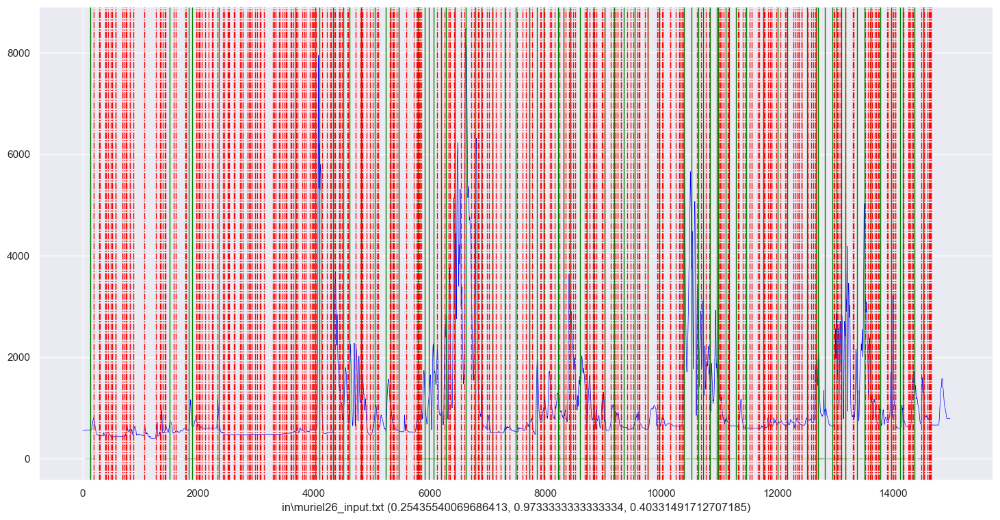

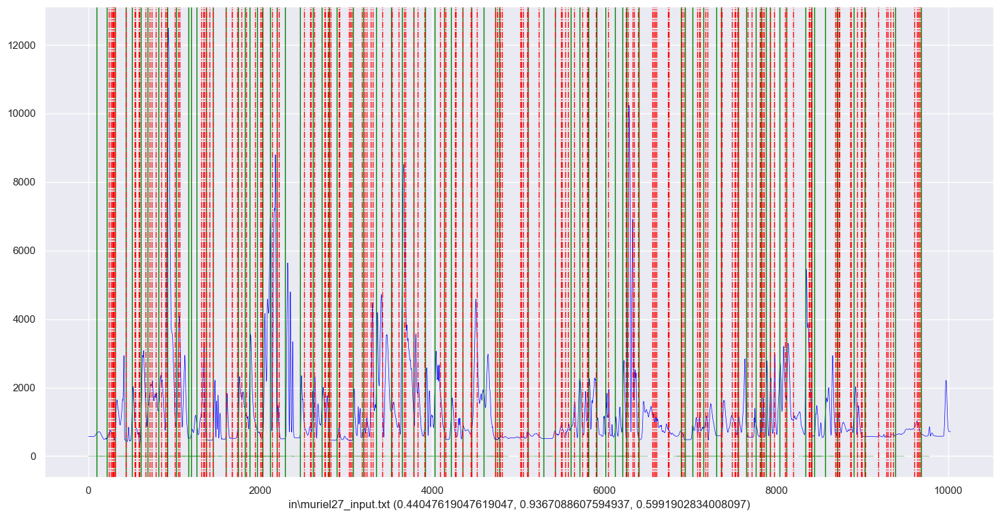

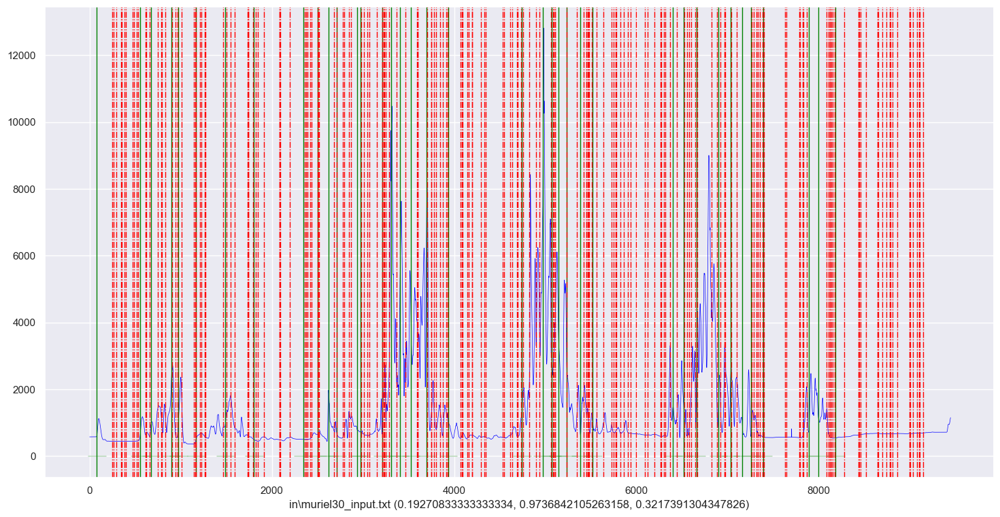

In [34]:
# suss, euclidean, 4
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="suss", distance="euclidean_distance", excl_radius=4,n_segments=len(gt), validation=None)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"suss euclidean 4 ",timeseries[i])

0
f1margin: (0.30985915492957744, 0.6875, 0.42718446601941745)
1
f1margin: (0.3076923076923077, 1.0, 0.47058823529411764)
2
f1margin: (0.16346153846153846, 1.0, 0.2809917355371901)
3
f1margin: (0.47058823529411764, 0.96, 0.631578947368421)
4
f1margin: (0.3090909090909091, 0.8095238095238095, 0.4473684210526316)
5
f1margin: (0.72, 0.6666666666666666, 0.6923076923076923)
6
f1margin: (0.8823529411764706, 0.5769230769230769, 0.6976744186046512)
7
f1margin: (0.6923076923076923, 0.6923076923076923, 0.6923076923076923)
8
f1margin: (0.8292682926829268, 0.7555555555555555, 0.7906976744186047)
9
f1margin: (0.3684210526315789, 0.6363636363636364, 0.4666666666666667)
10


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.6470588235294118, 0.5238095238095238, 0.5789473684210527)
11
f1margin: (0.375, 0.6923076923076923, 0.48648648648648646)
12
f1margin: (0.0625, 0.2222222222222222, 0.0975609756097561)
13
f1margin: (0.2708333333333333, 0.6666666666666666, 0.38518518518518513)
14


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.6363636363636364, 0.8235294117647058, 0.717948717948718)
15
f1margin: (0.3695652173913043, 1.0, 0.5396825396825397)
16
f1margin: (0.7142857142857143, 0.42857142857142855, 0.5357142857142858)
17
f1margin: (0.64, 0.4266666666666667, 0.512)
18
f1margin: (0.75, 0.759493670886076, 0.7547169811320755)
19
f1margin: (0.6923076923076923, 0.47368421052631576, 0.5625)


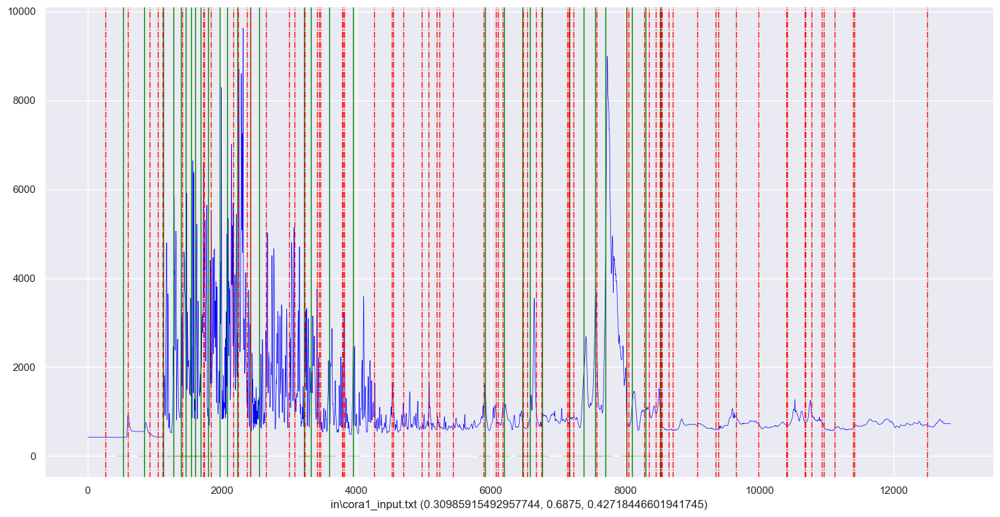

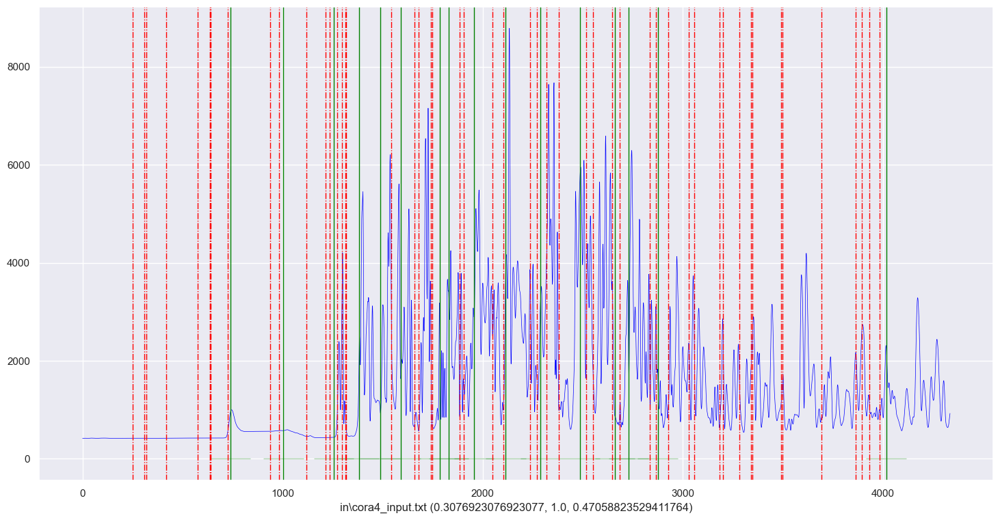

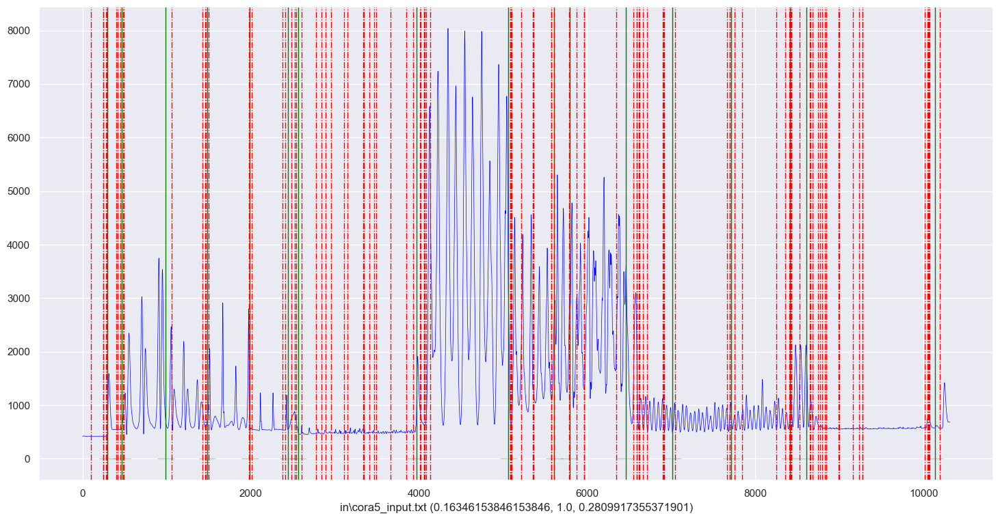

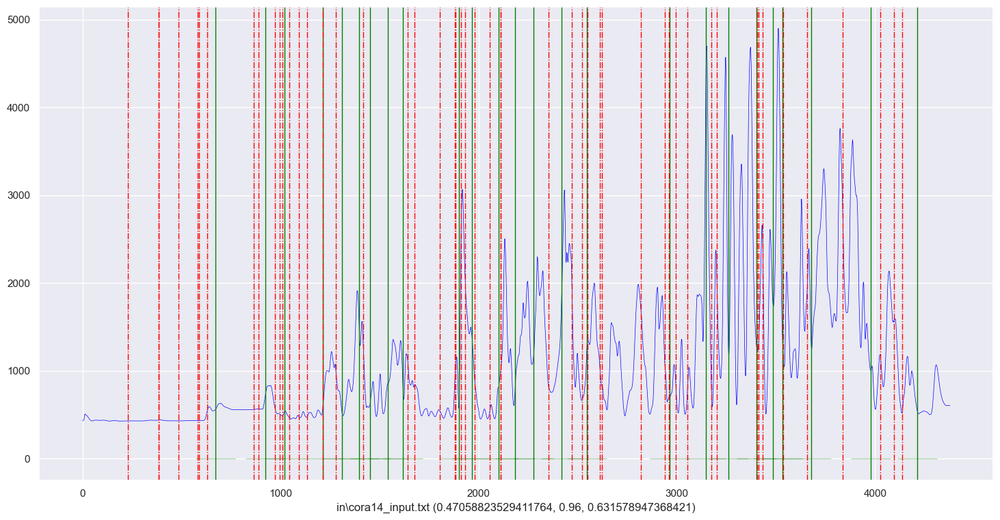

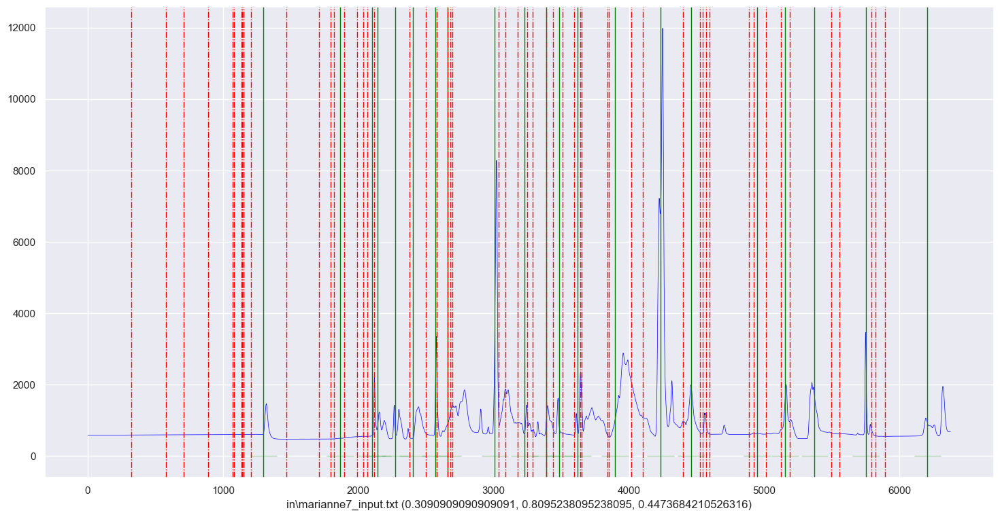

...

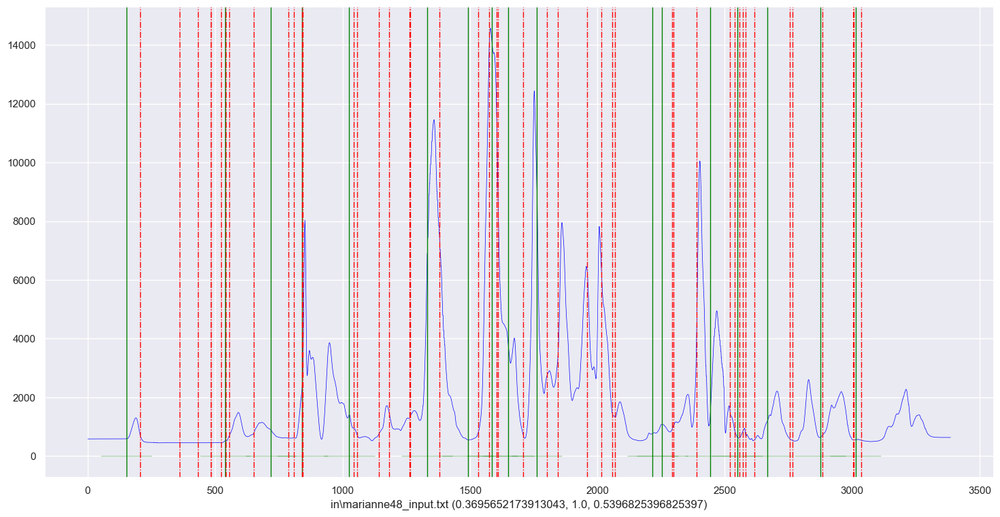

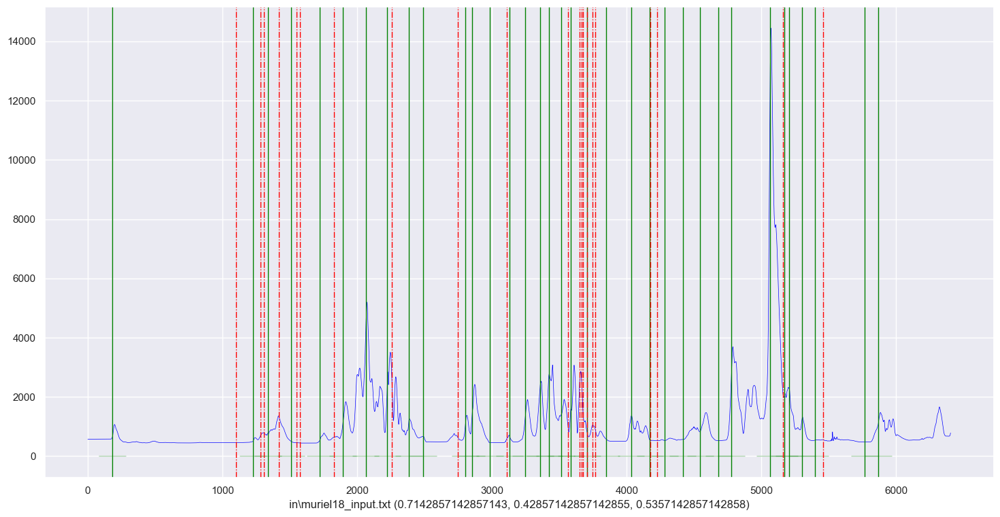

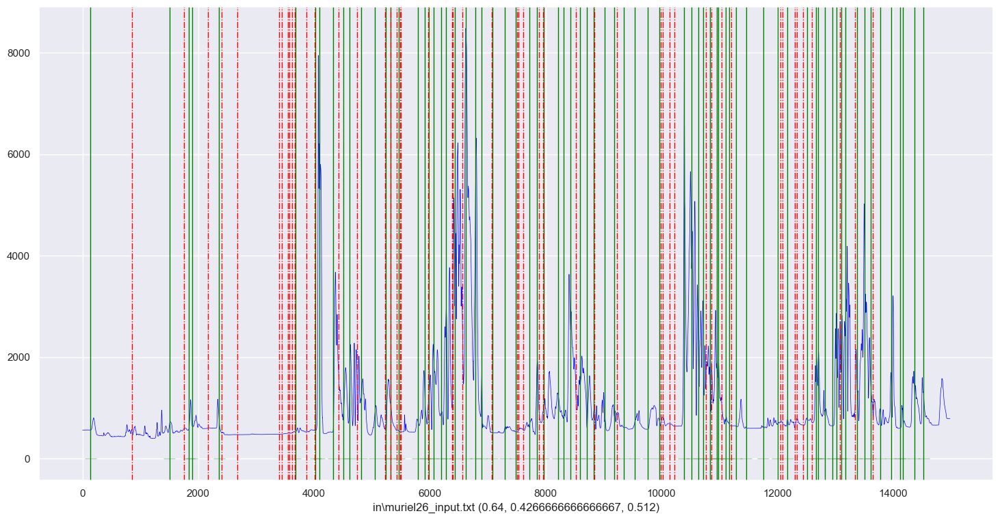

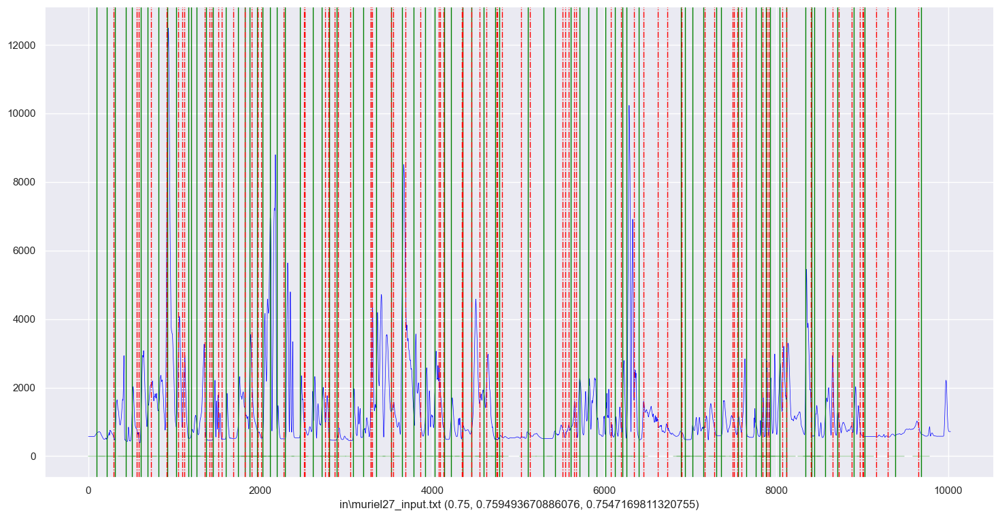

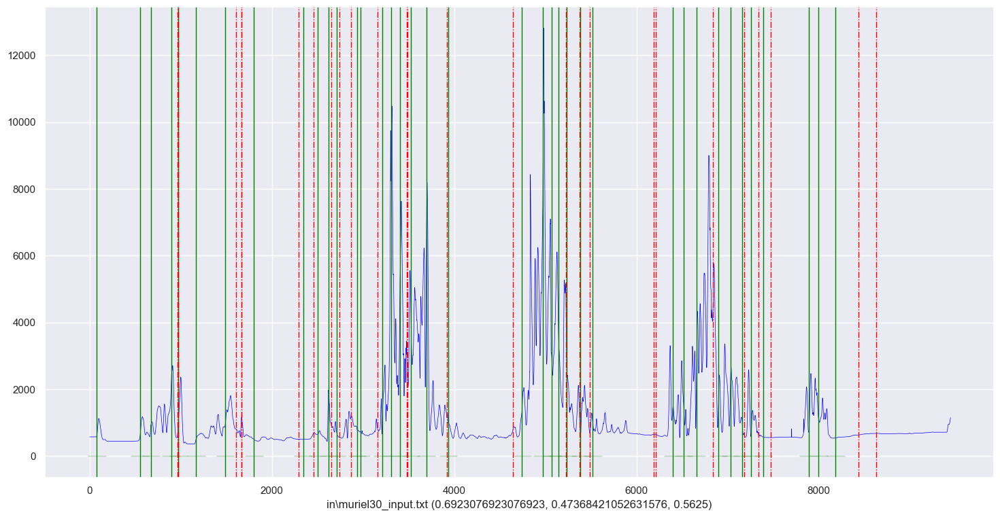

In [35]:
# fft, euclidean, 4
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="fft", distance="euclidean_distance", excl_radius=4,n_segments=len(gt), validation=None)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"fft euclidean 4 ",timeseries[i])

0
f1margin: (0.15897435897435896, 0.96875, 0.27312775330396477)
1
f1margin: (0.2459016393442623, 0.9375, 0.3896103896103896)
2
f1margin: (0.12318840579710146, 1.0, 0.2193548387096774)
3
f1margin: (0.2976190476190476, 1.0, 0.4587155963302752)
4
f1margin: (0.3114754098360656, 0.9047619047619048, 0.46341463414634154)
5
f1margin: (0.48, 0.8888888888888888, 0.6233766233766234)
6


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.6666666666666666, 0.6923076923076923, 0.6792452830188679)
7
f1margin: (0.7777777777777778, 0.5384615384615384, 0.6363636363636364)
8
f1margin: (0.2631578947368421, 1.0, 0.4166666666666667)
9
f1margin: (0.24675324675324675, 0.8636363636363636, 0.3838383838383838)
10
f1margin: (0.6470588235294118, 0.5238095238095238, 0.5789473684210527)
11


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.2857142857142857, 0.7692307692307693, 0.41666666666666663)
12


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\window_size.py:213: UserWarning: Could not find any autocorrelation peaks. Using window_size=10.
  warnings.warn(f"Could not find any autocorrelation peaks. Using window_size={lbound}.")


f1margin: (0.14754098360655737, 1.0, 0.2571428571428572)
13
f1margin: (0.1780821917808219, 1.0, 0.3023255813953488)
14


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.6956521739130435, 0.9411764705882353, 0.7999999999999999)
15


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.36363636363636365, 0.9411764705882353, 0.5245901639344263)
16
f1margin: (0.3333333333333333, 1.0, 0.5)
17
f1margin: (0.2329192546583851, 1.0, 0.37783375314861456)
18
f1margin: (0.42245989304812837, 1.0, 0.5939849624060151)
19
f1margin: (0.1735159817351598, 1.0, 0.2957198443579766)


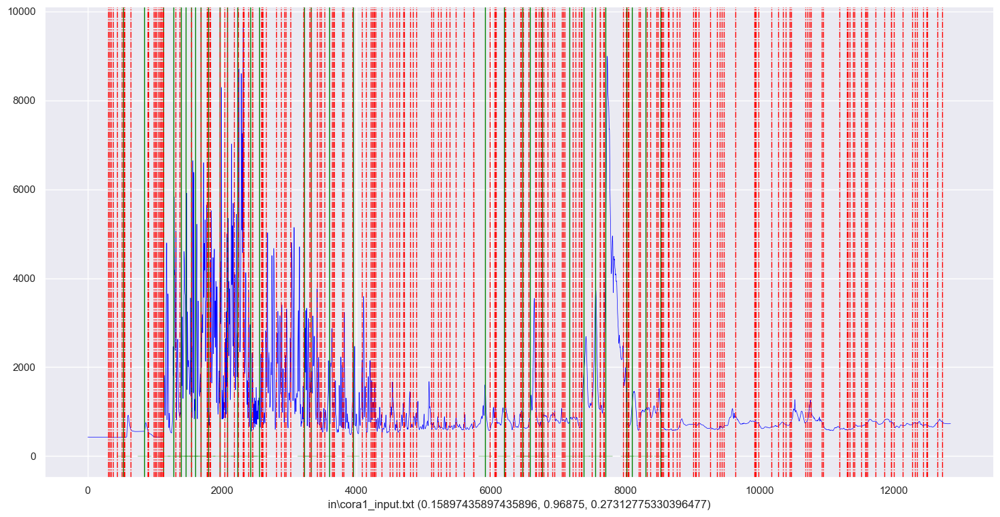

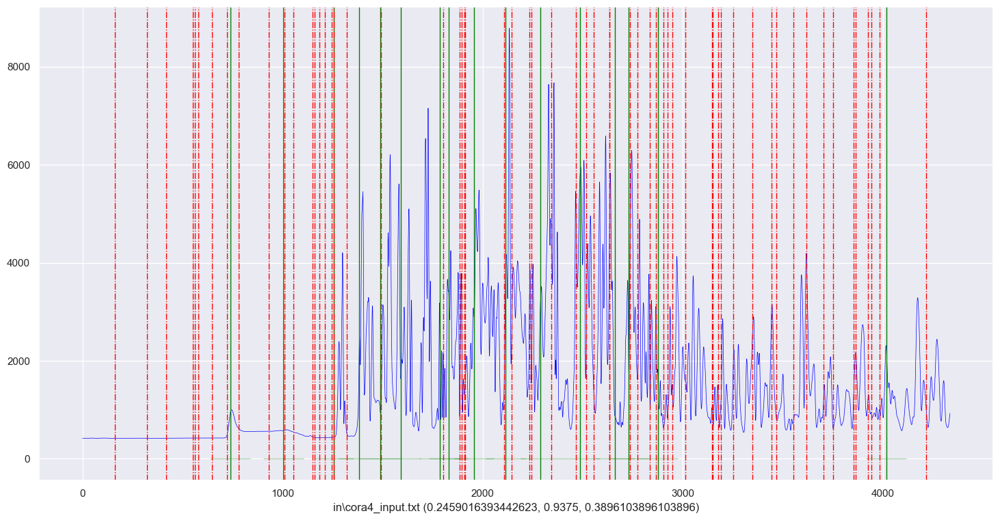

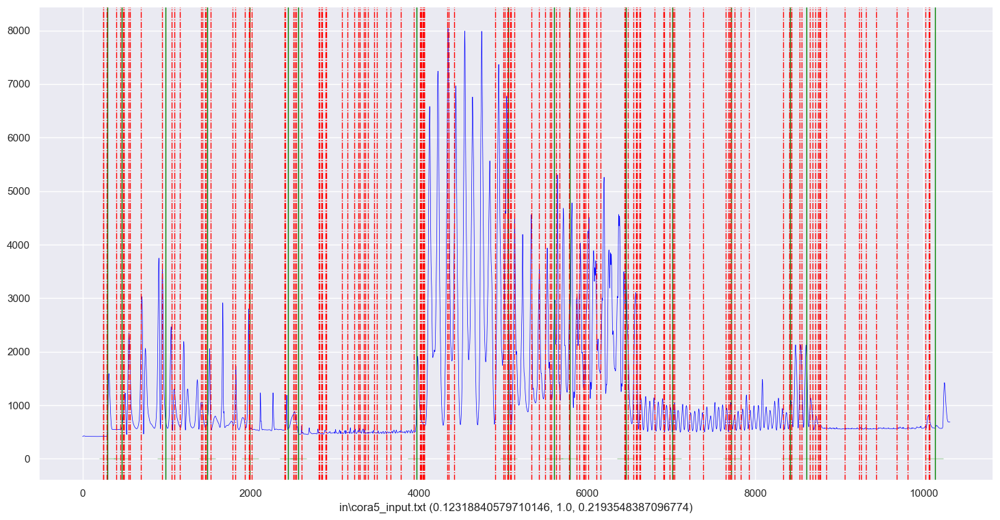

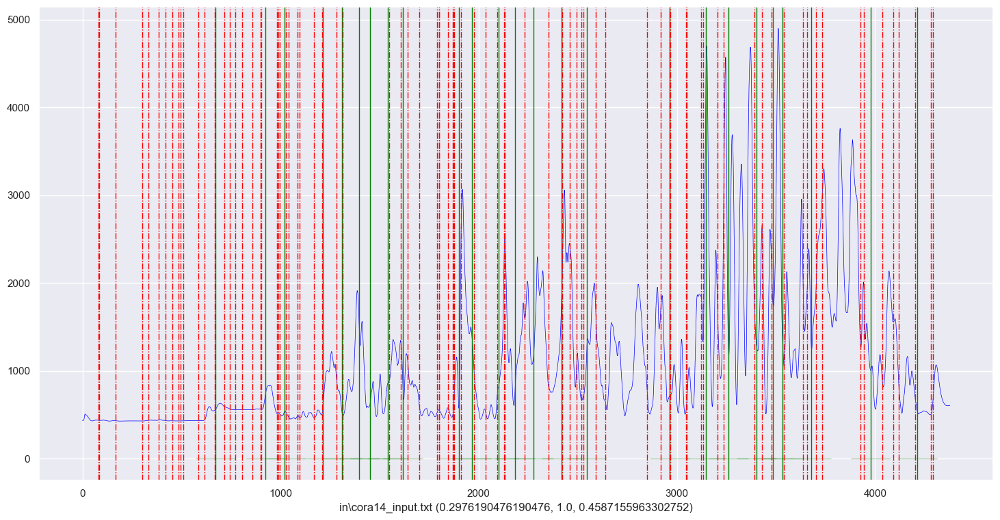

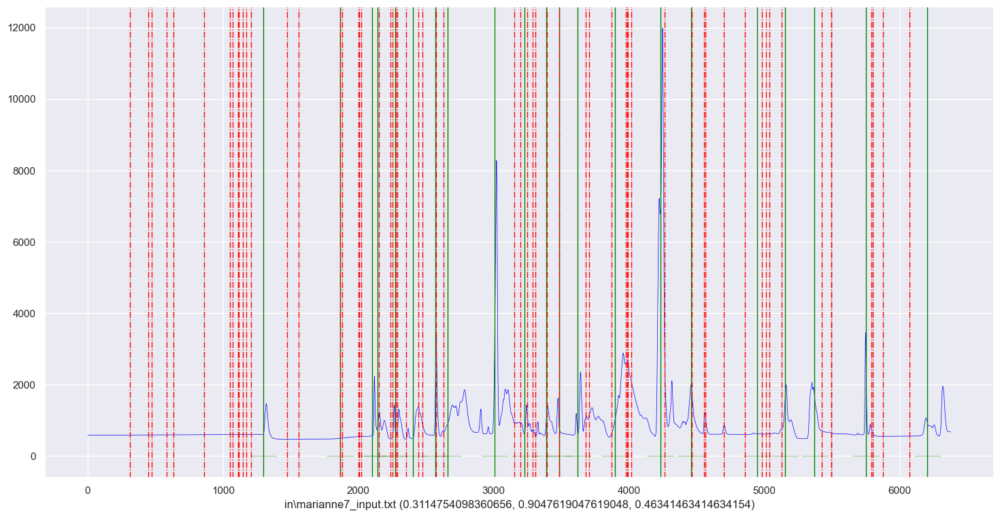

...

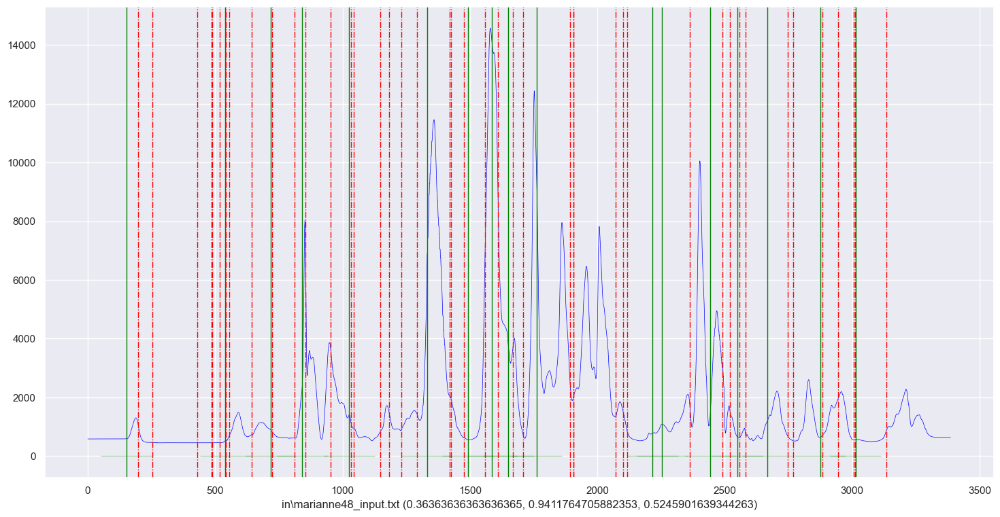

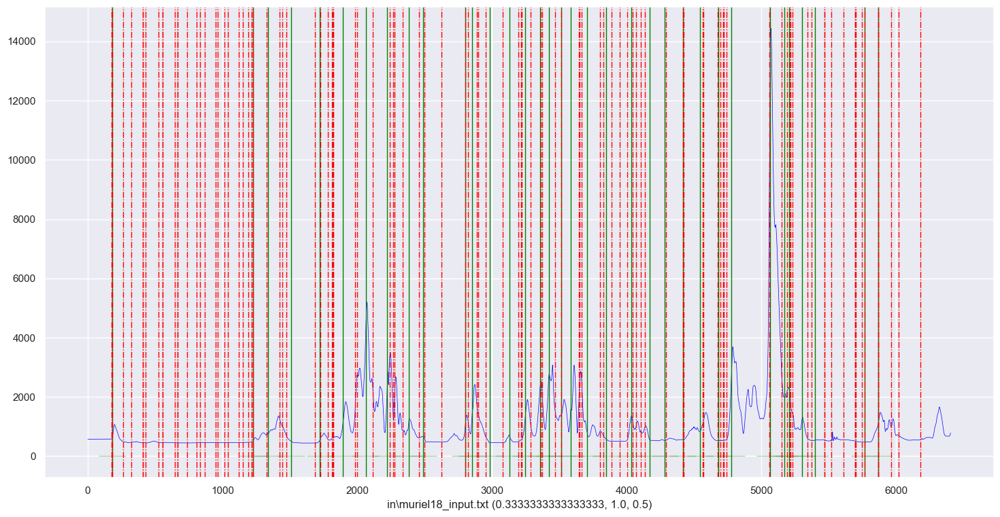

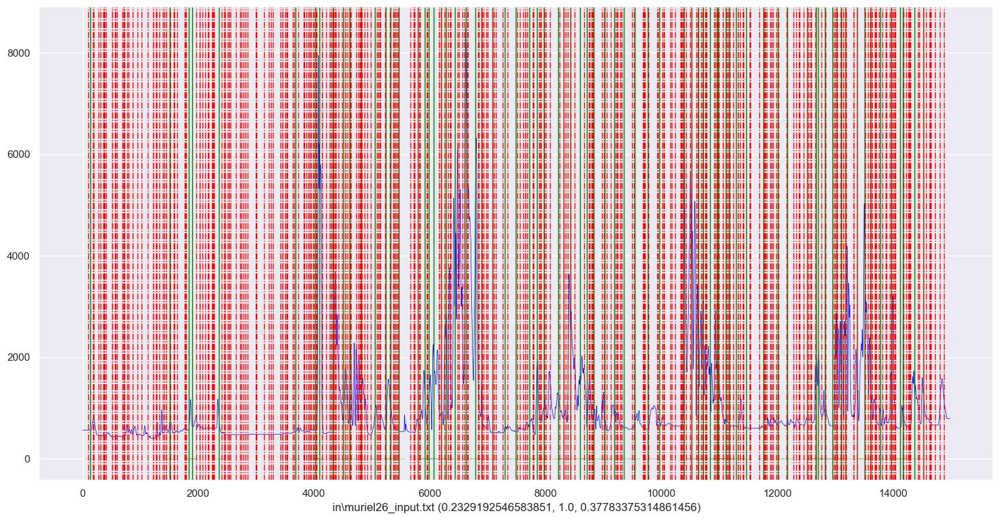

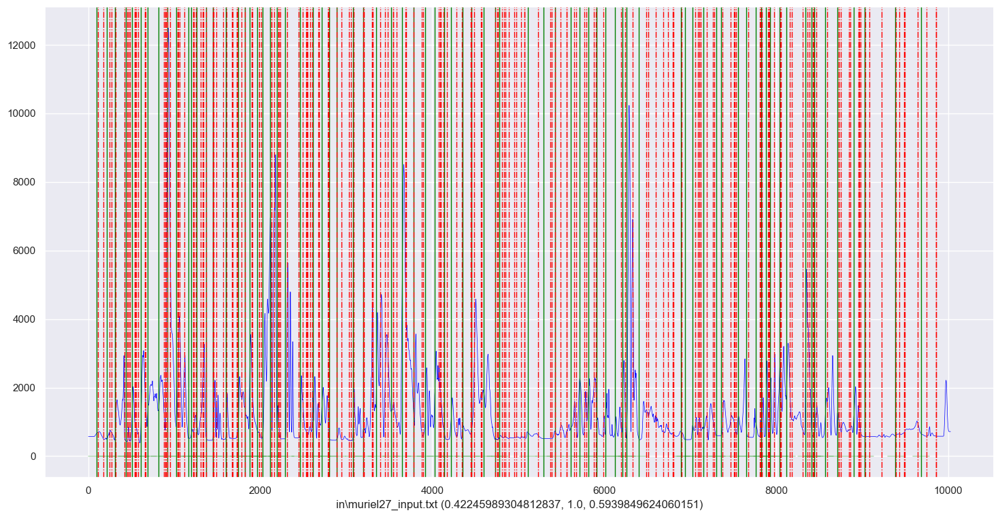

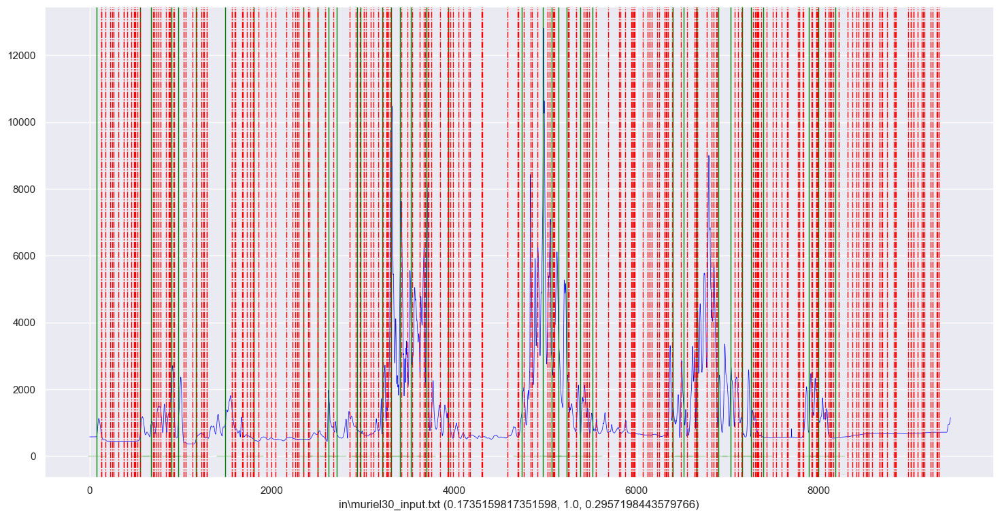

In [36]:
# acf, euclidean, 4
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="acf", distance="euclidean_distance", excl_radius=4,n_segments=len(gt), validation=None)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"acf euclidean 4 ",timeseries[i])